In [1]:
from hest import iter_hest, XeniumReader
from hest import h5ad_reader
from hest.h5ad_reader import *
import dask
dask.config.set({'dataframe.query-planning': False})
from pathlib import Path
import hest
print(hest.__version__)
import scanpy as sc
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd

# check gpu cucim
import cucim
print(cucim.__version__)
from cucim import CuImage

0.0.1
23.10.00


To speed up Xenium reader, use module load py-nvidia-rapids  # contains cucim

It requires gpu-ada

In [2]:
#sys.path.insert(0,'/home/k/kxu/.local/lib/python3.12/site-packages')
#import sys ; sys.path.insert(0,'/home/k/kxu/.local/lib/python3.11/site-packages')

In [3]:
# check gpu
# import subprocess

# try:
#     result = subprocess.run(["nvidia-smi"], capture_output=True, text=True, check=True)
#     print(result.stdout)
# except FileNotFoundError:
#     print("nvidia-smi not found (no NVIDIA driver or GPU not available).")
# except subprocess.CalledProcessError as e:
#     print("Error running nvidia-smi:", e.stderr)

# XeniumPR1S1ROI1

In [4]:
# --- load data ---
exp_stem = Path("/project/simmons_hts/shared/20_11_2024_xenium_prime_run1/20241113__143534__SIMMONS_super_secret_prime_run1/output-XETG00283__0043739__Region_1__20241113__143611")
img_path = Path("/project/simmons_hts/jpark/1_project/0_xenium/RUNTRexBio/post_HnE/CAM006_Xenium5K_post_HnE.ome.tif")
align_csv = Path("/project/simmons_hts/jpark/1_project/0_xenium/RUNTRexBio/post_HnE/CAM006_Xenium5K_post_HnE_matrix.csv")

st = load_xenium_dataset(exp_stem, img_path, align_csv, use_dask=True, spot_size_um = 50)

Loading the WSI... (can be slow for large images)
Loading transcripts...
Pooling xenium transcripts in pseudo-visium spots...


/package/python-cbrg/current/3.11.3/lib/python3.11/site-packages/anndata/_core/anndata.py:1105: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):


Reading cells...


/package/python-cbrg/current/3.11.3/lib/python3.11/site-packages/anndata/_core/anndata.py:1105: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):


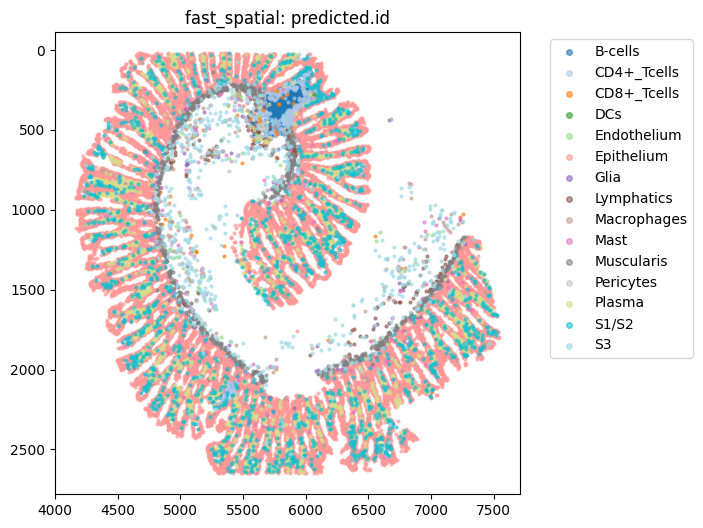

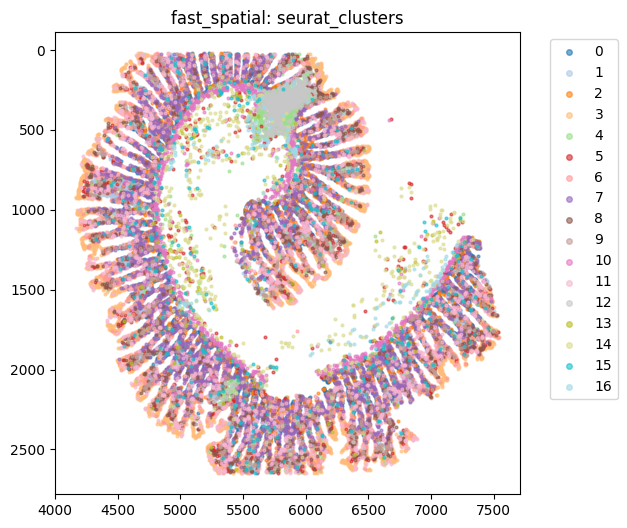

/package/python-cbrg/current/3.11.3/lib/python3.11/site-packages/anndata/_core/anndata.py:1105: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):


In [ ]:
# --- labelled single-cell data ---
adata_labelled = sc.read_h5ad("/project/simmons_hts/kxu/hest/xenium_labelled/h5ad/XeniumPR1S1ROI1.h5ad")

adata_labelled.obsm["spatial"] = adata_labelled.obs[["cell_centroid_x","cell_centroid_y"]].to_numpy()

fast_spatial(adata_labelled, 'predicted.id')
fast_spatial(adata_labelled, 'seurat_clusters')

# --- filter st.adata to WSI extent + drop Codeword features ---
update_st_with_filtered_and_labelled(st, adata_labelled, drop_codeword=True)

# --- align labelled cells to H&E pixel coords ---
px_um = st.meta["pixel_size"]
adata_labelled = align_labelled_to_he(adata_labelled, align_csv, pixel_size_um=px_um)

# standardize column names / annotate
adata_labelled = standardize_obs_columns(adata_labelled)
fast_spatial(adata_labelled, 'cell_type')

# --- quick sanity range of aligned coords ---
x_min, x_max, y_min, y_max = coord_range(adata_labelled.obsm["spatial"])
print(f"x:[{x_min:.1f}, {x_max:.1f}], y:[{y_min:.1f}, {y_max:.1f}]")

Spots kept after rules: 3922 / 3922


/package/python-cbrg/current/3.11.3/lib/python3.11/site-packages/anndata/_core/anndata.py:1105: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):
/tmp/ipykernel_1867599/1730020794.py:22: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  sc.pl.spatial(


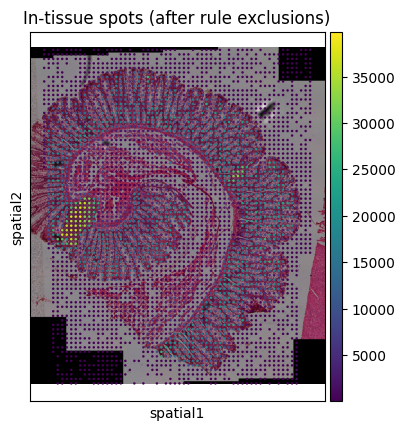

In [8]:
# --- spot exclusions across full WSI ---

# get spot coords from st.adata
xy = st.adata.obsm["spatial"]
sx, sy = xy[:, 0], xy[:, 1]

# full WSI bounding box
xmin, xmax, ymin, ymax = 0, st.wsi.width, 0, st.wsi.height

# rules (edit as you like)
rules = [
    {"type": "strip", "side": "right", "size": 0.10, "units": "frac"},
    {'type':'corner', 'corner':'bottom-right', 'width':0.13, 'height':0.38, 'units':'frac'}
]

# apply rule-based exclusions directly
final_keep = apply_spot_exclusions(sx, sy, (xmin, xmax, ymin, ymax), rules)

print(f"Spots kept after rules: {final_keep.sum()} / {len(final_keep)}")

# visualize with scanpy
sc.pl.spatial(
    st.adata[final_keep],
    img_key="downscaled_fullres",
    color="total_counts",
    title="In-tissue spots (after rule exclusions)",
    size = 0.5
)

Before/After: {'old': {'num_cells': 26577, 'cells_under_tissue': 26577, 'transcripts_per_cell': 115.7133988034767, 'total_cell_area': 442995.8399666354}, 'new': {'num_cells': 26577, 'cells_under_tissue': 26577, 'transcripts_per_cell': 115.7133988034767, 'total_cell_area': 442995.8399666354}}


/home/k/kxu/.local/lib/python3.11/site-packages/hest/HESTData.py:1390: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  fig = sc.pl.spatial(adata, show=False, img_key="downscaled_fullres", color=[key], title=f"in_tissue spots", return_fig=True, **pl_kwargs)


saving to pyramidal tiff... can be slow


/home/k/kxu/.local/lib/python3.11/site-packages/hest/h5ad_reader.py:319: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


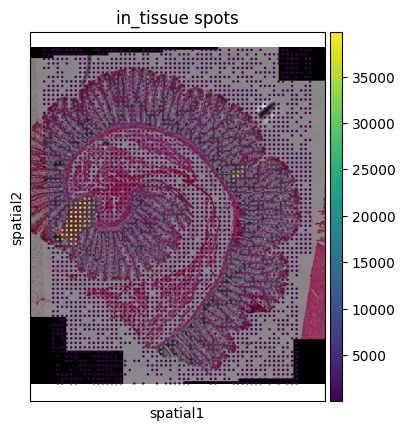

Overlay saved: /project/simmons_hts/kxu/hest/xenium_data/XeniumPR1_50um/slide1/ROI1/cell_plot.png


In [9]:
# reattach (after alignment/renames)
st.adata = st.adata[final_keep]
st.cell_adata = adata_labelled

# --- meta refresh ---
stats = refresh_meta_counts(st)
print("Before/After:", stats)

out_dir = Path("/project/simmons_hts/kxu/hest/xenium_data/XeniumPR1_50um/slide1/ROI1")
overlay_path = save_all(st, save_dir = out_dir,size=0.5)
print("Overlay saved:", overlay_path)

# XeniumPR1S1ROI2

In [10]:
# --- load data ---
exp_stem = Path("/project/simmons_hts/shared/20_11_2024_xenium_prime_run1/20241113__143534__SIMMONS_super_secret_prime_run1/output-XETG00283__0043739__Region_1__20241113__143611")
img_path = Path("/project/simmons_hts/jpark/1_project/0_xenium/RUNTRexBio/post_HnE/TIP877_Xenium5K_post_HnE.ome.tif")
align_csv = Path("/project/simmons_hts/jpark/1_project/0_xenium/RUNTRexBio/post_HnE/TIP877_Xenium5K_post_HnE_matrix.csv")

st = load_xenium_dataset(exp_stem, img_path, align_csv, use_dask=True, spot_size_um = 50)

Loading the WSI... (can be slow for large images)
Loading transcripts...
Pooling xenium transcripts in pseudo-visium spots...


/package/python-cbrg/current/3.11.3/lib/python3.11/site-packages/anndata/_core/anndata.py:1105: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):


Reading cells...


/package/python-cbrg/current/3.11.3/lib/python3.11/site-packages/anndata/_core/anndata.py:1105: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):


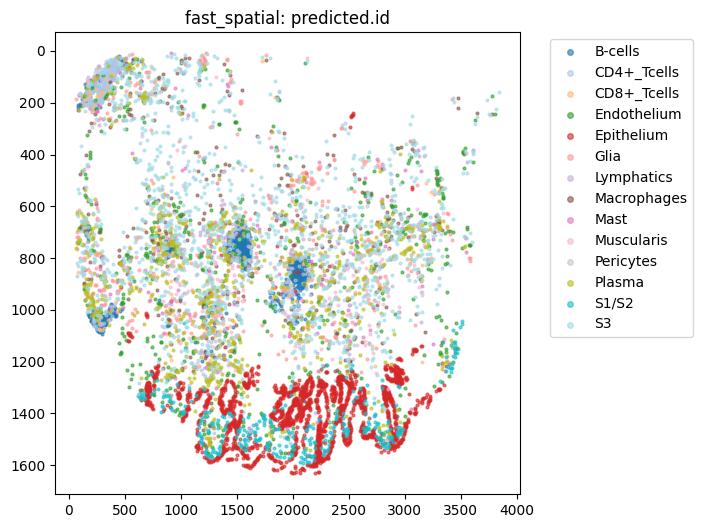

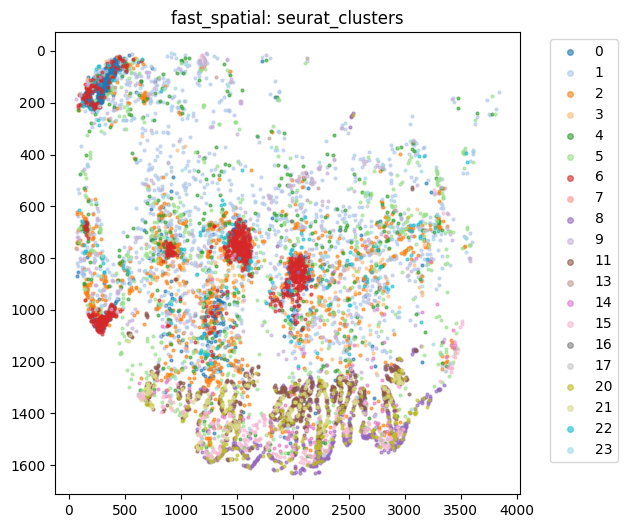

/package/python-cbrg/current/3.11.3/lib/python3.11/site-packages/anndata/_core/anndata.py:1105: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):


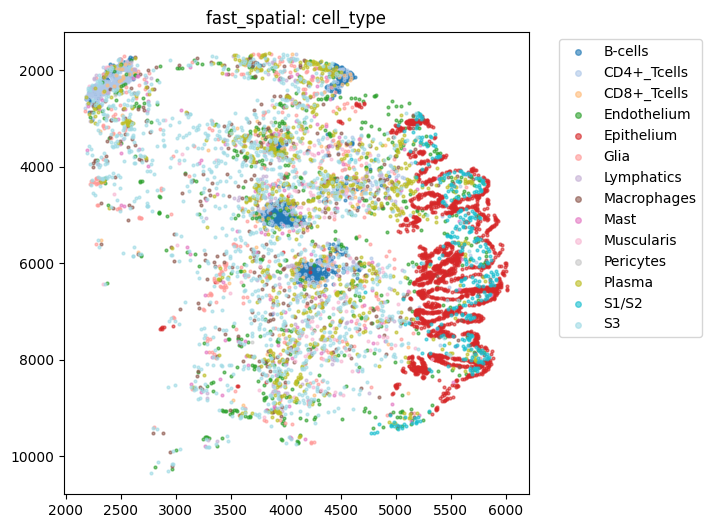

x:[2172.9, 6014.4], y:[1647.4, 10356.5]


In [12]:
# --- labelled single-cell data ---
adata_labelled = sc.read_h5ad("/project/simmons_hts/kxu/hest/xenium_labelled/h5ad/XeniumPR1S1ROI2.h5ad")

adata_labelled.obsm["spatial"] = adata_labelled.obs[["cell_centroid_x","cell_centroid_y"]].to_numpy()

fast_spatial(adata_labelled, 'predicted.id')
fast_spatial(adata_labelled, 'seurat_clusters')

# --- filter st.adata to WSI extent + drop Codeword features ---
update_st_with_filtered_and_labelled(st, adata_labelled, drop_codeword=True)

# --- align labelled cells to H&E pixel coords ---
px_um = st.meta["pixel_size"]
adata_labelled = align_labelled_to_he(adata_labelled, align_csv, pixel_size_um=px_um)

# standardize column names / annotate
adata_labelled = standardize_obs_columns(adata_labelled)
fast_spatial(adata_labelled, 'cell_type')

# --- quick sanity range of aligned coords ---
x_min, x_max, y_min, y_max = coord_range(adata_labelled.obsm["spatial"])
print(f"x:[{x_min:.1f}, {x_max:.1f}], y:[{y_min:.1f}, {y_max:.1f}]")

Before/After: {'old': {'num_cells': 1074150, 'cells_under_tissue': 1074150, 'transcripts_per_cell': 156, 'total_cell_area': 55846944.49765815}, 'new': {'num_cells': 7476, 'cells_under_tissue': 7476, 'transcripts_per_cell': 71.56861958266452, 'total_cell_area': 116343.38721884842}}


/home/k/kxu/.local/lib/python3.11/site-packages/hest/HESTData.py:1390: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  fig = sc.pl.spatial(adata, show=False, img_key="downscaled_fullres", color=[key], title=f"in_tissue spots", return_fig=True, **pl_kwargs)


saving to pyramidal tiff... can be slow


/home/k/kxu/.local/lib/python3.11/site-packages/hest/h5ad_reader.py:319: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


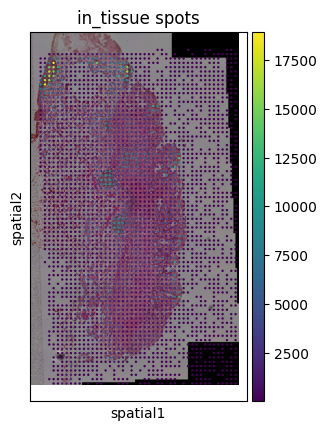

Overlay saved: /project/simmons_hts/kxu/hest/xenium_data/XeniumPR1_50um/slide1/ROI2/cell_plot.png


In [13]:
st.cell_adata = adata_labelled

# --- meta refresh ---
stats = refresh_meta_counts(st)
print("Before/After:", stats)

out_dir = Path("/project/simmons_hts/kxu/hest/xenium_data/XeniumPR1_50um/slide1/ROI2")
overlay_path = save_all(st, save_dir = out_dir,size=0.5)
print("Overlay saved:", overlay_path)

# XeniumPR1S1ROI3

In [14]:
# --- load data ---
exp_stem = Path("/project/simmons_hts/shared/20_11_2024_xenium_prime_run1/20241113__143534__SIMMONS_super_secret_prime_run1/output-XETG00283__0043739__Region_1__20241113__143611")
img_path = Path("/project/simmons_hts/jpark/1_project/0_xenium/RUNTRexBio/post_HnE/GI9389_Xenium5K_post_HnE.ome.tif")
align_csv = Path("/project/simmons_hts/jpark/1_project/0_xenium/RUNTRexBio/post_HnE/GI9389_Xenium5K_post_HnE_matrix.csv")

st = load_xenium_dataset(exp_stem, img_path, align_csv, use_dask=True, spot_size_um = 50)

Loading the WSI... (can be slow for large images)
Loading transcripts...
Pooling xenium transcripts in pseudo-visium spots...
Reading cells...


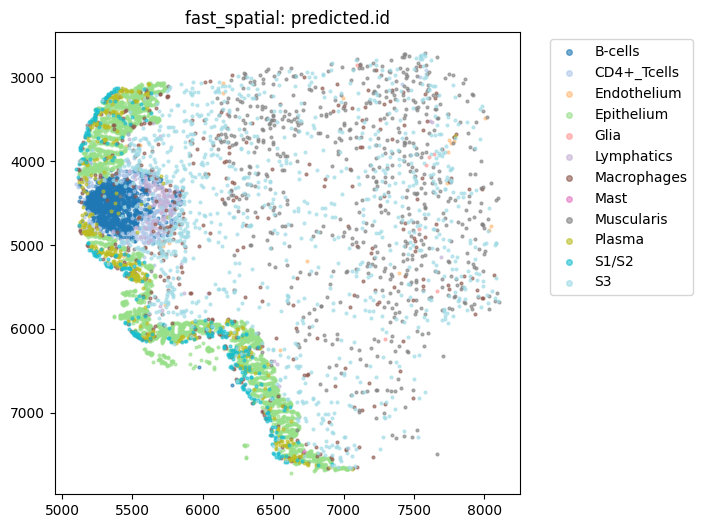

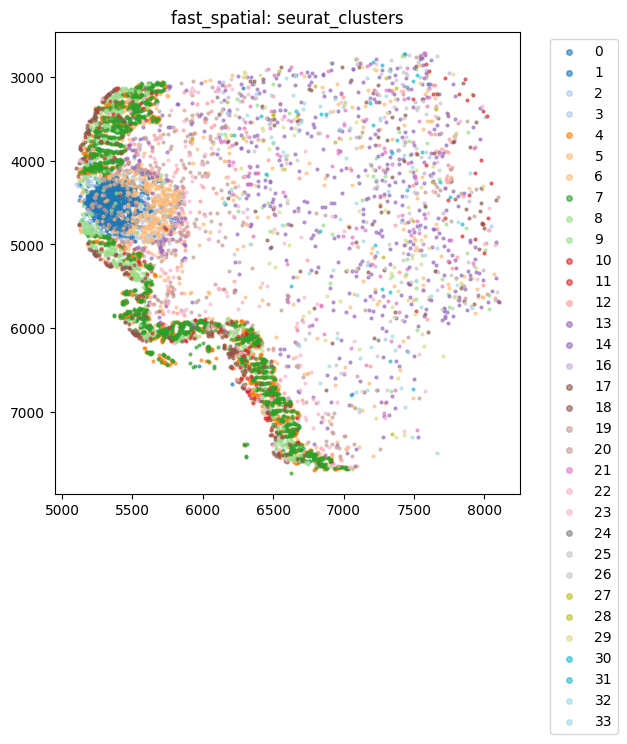

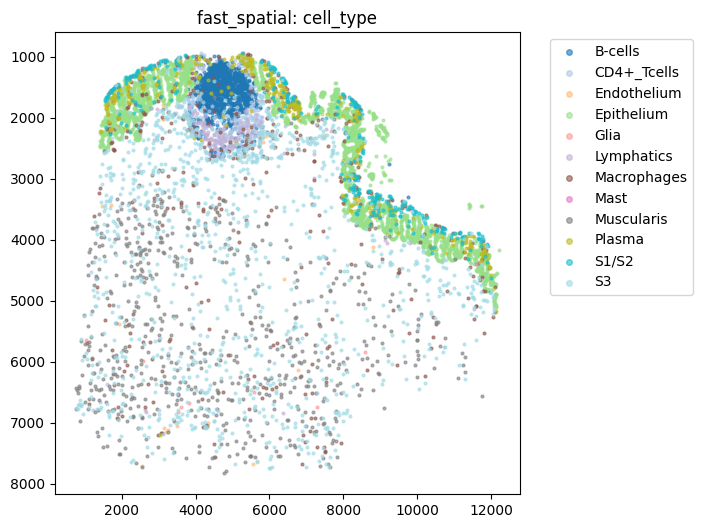

x:[760.1, 12207.8], y:[945.6, 7827.1]


In [15]:
# --- labelled single-cell data ---
adata_labelled = sc.read_h5ad("/project/simmons_hts/kxu/hest/xenium_labelled/h5ad/XeniumPR1S1ROI3.h5ad")

adata_labelled.obsm["spatial"] = adata_labelled.obs[["cell_centroid_x","cell_centroid_y"]].to_numpy()

fast_spatial(adata_labelled, 'predicted.id')
fast_spatial(adata_labelled, 'seurat_clusters')

# --- filter st.adata to WSI extent + drop Codeword features ---
update_st_with_filtered_and_labelled(st, adata_labelled, drop_codeword=True)

# --- align labelled cells to H&E pixel coords ---
px_um = st.meta["pixel_size"]
adata_labelled = align_labelled_to_he(adata_labelled, align_csv, pixel_size_um=px_um)

# standardize column names / annotate
adata_labelled = standardize_obs_columns(adata_labelled)
fast_spatial(adata_labelled, 'cell_type')

# --- quick sanity range of aligned coords ---
x_min, x_max, y_min, y_max = coord_range(adata_labelled.obsm["spatial"])
print(f"x:[{x_min:.1f}, {x_max:.1f}], y:[{y_min:.1f}, {y_max:.1f}]")

Spots kept after rules: 6997 / 7683


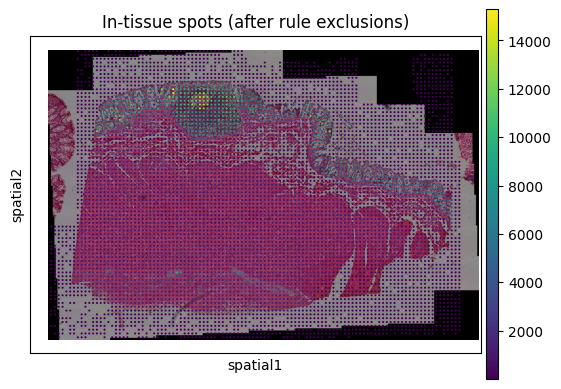

In [30]:
# --- spot exclusions across full WSI ---

# get spot coords from st.adata
xy = st.adata.obsm["spatial"]
sx, sy = xy[:, 0], xy[:, 1]

# full WSI bounding box
xmin, xmax, ymin, ymax = 0, st.wsi.width, 0, st.wsi.height

# rules (edit as you like)
rules = [
    {'type':'corner', 'corner':'top-left', 'width':0.06, 'height':0.6, 'units':'frac'},
    {'type':'corner', 'corner':'top-right', 'width':0.06, 'height':0.37, 'units':'frac'},
    {"type": "strip", "side": "right", "size": 0.04, "units": "frac"}
]

# apply rule-based exclusions directly
final_keep = apply_spot_exclusions(sx, sy, (xmin, xmax, ymin, ymax), rules)

print(f"Spots kept after rules: {final_keep.sum()} / {len(final_keep)}")

# visualize with scanpy
sc.pl.spatial(
    st.adata[final_keep],
    img_key="downscaled_fullres",
    color="total_counts",
    title="In-tissue spots (after rule exclusions)",
    size = 0.5
)

Before/After: {'old': {'num_cells': 1074150, 'cells_under_tissue': 1074150, 'transcripts_per_cell': 156, 'total_cell_area': 55846944.49765815}, 'new': {'num_cells': 7375, 'cells_under_tissue': 7375, 'transcripts_per_cell': 66.00881355932204, 'total_cell_area': 118138.61459176126}}
saving to pyramidal tiff... can be slow


/home/k/kxu/.local/lib/python3.11/site-packages/hest/h5ad_reader.py:319: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


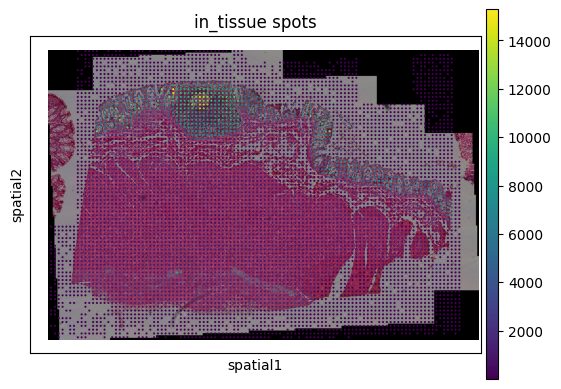

Overlay saved: /project/simmons_hts/kxu/hest/xenium_data/XeniumPR1_50um/slide1/ROI3/cell_plot.png


In [31]:
# reattach (after alignment/renames)
st.adata = st.adata[final_keep]
st.cell_adata = adata_labelled

# --- meta refresh ---
stats = refresh_meta_counts(st)
print("Before/After:", stats)

out_dir = Path("/project/simmons_hts/kxu/hest/xenium_data/XeniumPR1_50um/slide1/ROI3")
overlay_path = save_all(st, save_dir = out_dir,size=0.5)
print("Overlay saved:", overlay_path)

# XeniumPR1S1ROI4

In [32]:
# --- load data ---
exp_stem = Path("/project/simmons_hts/shared/20_11_2024_xenium_prime_run1/20241113__143534__SIMMONS_super_secret_prime_run1/output-XETG00283__0043739__Region_1__20241113__143611")
img_path = Path("/project/simmons_hts/jpark/1_project/0_xenium/RUNTRexBio/post_HnE/GI9077_Xenium5K_post_HnE.ome.tif")
align_csv = Path("/project/simmons_hts/jpark/1_project/0_xenium/RUNTRexBio/post_HnE/GI9077_Xenium5K_post_HnE_matrix.csv")

st = load_xenium_dataset(exp_stem, img_path, align_csv, use_dask=True, spot_size_um = 50)

Loading the WSI... (can be slow for large images)
Loading transcripts...
Pooling xenium transcripts in pseudo-visium spots...
Reading cells...


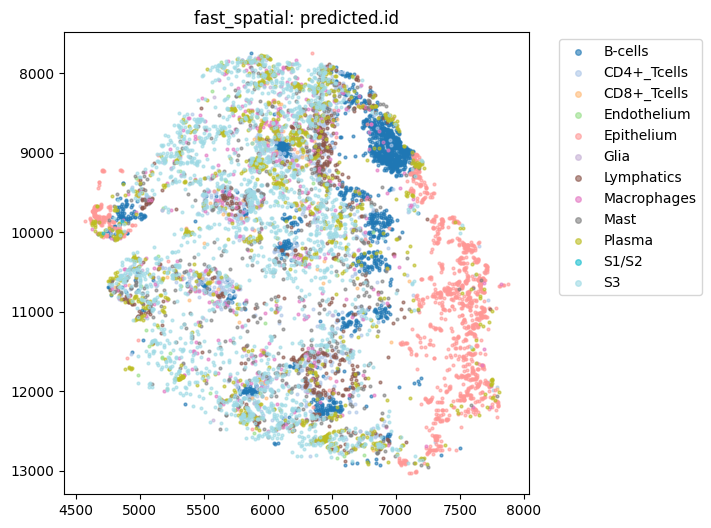

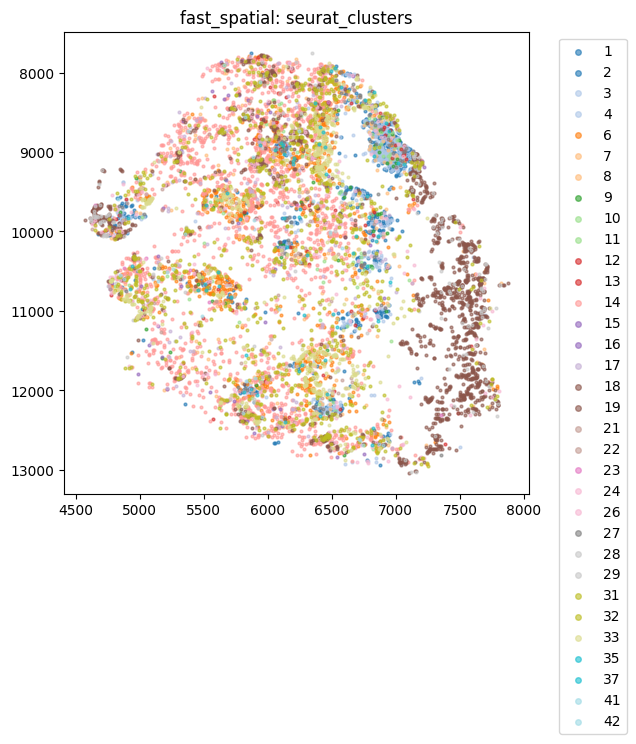

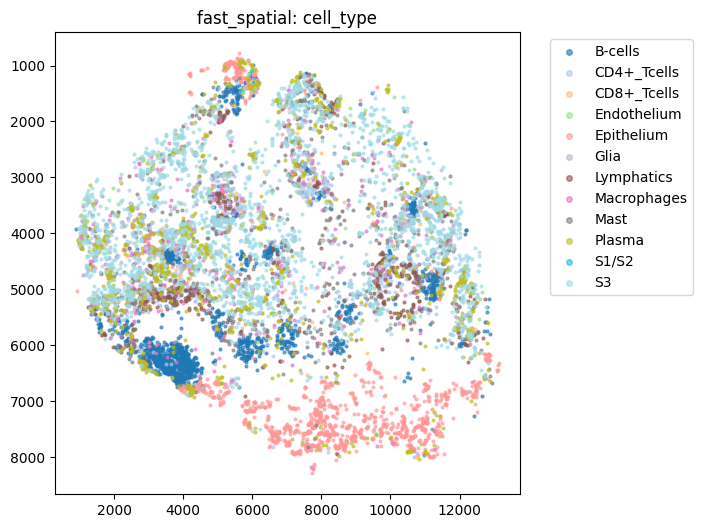

x:[898.0, 13133.0], y:[781.0, 8291.2]


In [33]:
# --- labelled single-cell data ---
adata_labelled = sc.read_h5ad("/project/simmons_hts/kxu/hest/xenium_labelled/h5ad/XeniumPR1S1ROI4.h5ad")

adata_labelled.obsm["spatial"] = adata_labelled.obs[["cell_centroid_x","cell_centroid_y"]].to_numpy()

fast_spatial(adata_labelled, 'predicted.id')
fast_spatial(adata_labelled, 'seurat_clusters')

# --- filter st.adata to WSI extent + drop Codeword features ---
update_st_with_filtered_and_labelled(st, adata_labelled, drop_codeword=True)

# --- align labelled cells to H&E pixel coords ---
px_um = st.meta["pixel_size"]
adata_labelled = align_labelled_to_he(adata_labelled, align_csv, pixel_size_um=px_um)

# standardize column names / annotate
adata_labelled = standardize_obs_columns(adata_labelled)
fast_spatial(adata_labelled, 'cell_type')

# --- quick sanity range of aligned coords ---
x_min, x_max, y_min, y_max = coord_range(adata_labelled.obsm["spatial"])
print(f"x:[{x_min:.1f}, {x_max:.1f}], y:[{y_min:.1f}, {y_max:.1f}]")

Spots kept after rules: 8140 / 8396


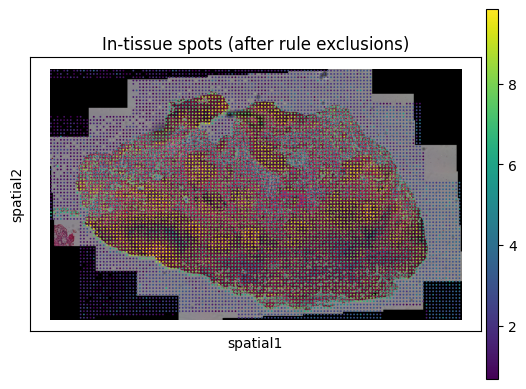

In [37]:
  # --- spot exclusions across full WSI ---

# get spot coords from st.adata
xy = st.adata.obsm["spatial"]
sx, sy = xy[:, 0], xy[:, 1]

# full WSI bounding box
xmin, xmax, ymin, ymax = 0, st.wsi.width, 0, st.wsi.height

# rules (edit as you like)
rules = [
    {'type':'corner', 'corner':'bottom-left', 'width':0.07, 'height':0.4, 'units':'frac'},
]

# apply rule-based exclusions directly
final_keep = apply_spot_exclusions(sx, sy, (xmin, xmax, ymin, ymax), rules)

print(f"Spots kept after rules: {final_keep.sum()} / {len(final_keep)}")

# visualize with scanpy
sc.pl.spatial(
    st.adata[final_keep],
    img_key="downscaled_fullres",
    color="log1p_total_counts",
    title="In-tissue spots (after rule exclusions)",
    size = 0.5
)

Before/After: {'old': {'num_cells': 1074150, 'cells_under_tissue': 1074150, 'transcripts_per_cell': 156, 'total_cell_area': 55846944.49765815}, 'new': {'num_cells': 8507, 'cells_under_tissue': 8507, 'transcripts_per_cell': 45.89491007405666, 'total_cell_area': 130238.31756915661}}
saving to pyramidal tiff... can be slow


/home/k/kxu/.local/lib/python3.11/site-packages/hest/h5ad_reader.py:319: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


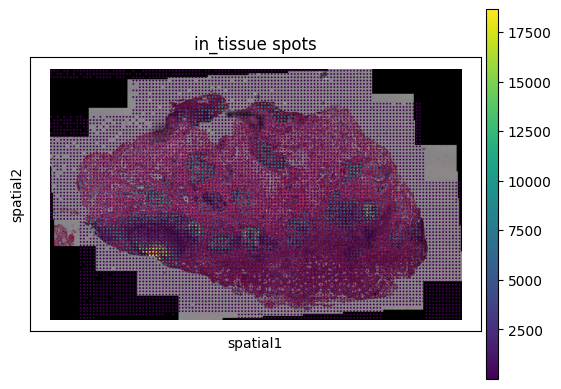

Overlay saved: /project/simmons_hts/kxu/hest/xenium_data/XeniumPR1_50um/slide1/ROI4/cell_plot.png


In [38]:
# reattach (after alignment/renames)
st.adata = st.adata[final_keep]
st.cell_adata = adata_labelled

# --- meta refresh ---
stats = refresh_meta_counts(st)
print("Before/After:", stats)

out_dir = Path("/project/simmons_hts/kxu/hest/xenium_data/XeniumPR1_50um/slide1/ROI4")
overlay_path = save_all(st, save_dir = out_dir,size=0.5)
print("Overlay saved:", overlay_path)

# XeniumPR1S1ROI5

In [2]:
# --- load data ---
exp_stem = Path("/project/simmons_hts/shared/20_11_2024_xenium_prime_run1/20241113__143534__SIMMONS_super_secret_prime_run1/output-XETG00283__0043739__Region_1__20241113__143611")
img_path = Path("/project/simmons_hts/jpark/1_project/0_xenium/RUNTRexBio/post_HnE/GI9612_Xenium5K_post_HnE.ome.tif")
align_csv = Path("/project/simmons_hts/jpark/1_project/0_xenium/RUNTRexBio/post_HnE/GI9612_Xenium5K_post_HnE_matrix.csv")

st = load_xenium_dataset(exp_stem, img_path, align_csv, use_dask=True, spot_size_um = 50)

Loading the WSI... (can be slow for large images)
Loading transcripts...
Pooling xenium transcripts in pseudo-visium spots...
Reading cells...


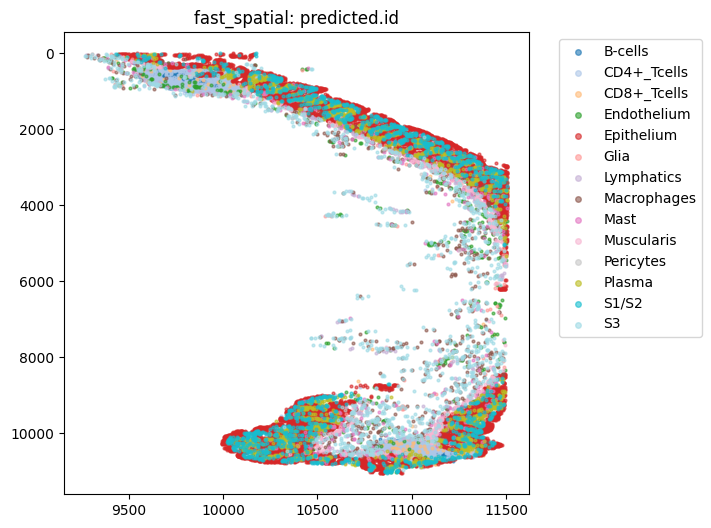

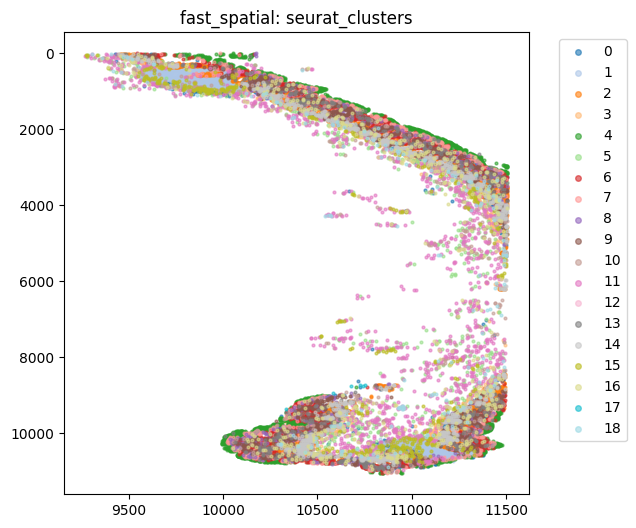

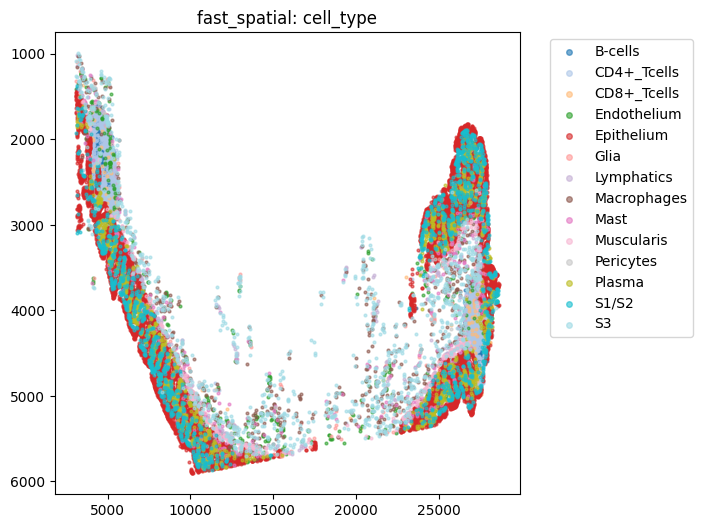

x:[3086.3, 28621.2], y:[992.3, 5904.2]


In [3]:
# --- labelled single-cell data ---
adata_labelled = sc.read_h5ad("/project/simmons_hts/kxu/hest/xenium_labelled/h5ad/XeniumPR1S1ROI5.h5ad")

adata_labelled.obsm["spatial"] = adata_labelled.obs[["cell_centroid_x","cell_centroid_y"]].to_numpy()

fast_spatial(adata_labelled, 'predicted.id')
fast_spatial(adata_labelled, 'seurat_clusters')

# --- filter st.adata to WSI extent + drop Codeword features ---
update_st_with_filtered_and_labelled(st, adata_labelled, drop_codeword=True)

# --- align labelled cells to H&E pixel coords ---
px_um = st.meta["pixel_size"]
adata_labelled = align_labelled_to_he(adata_labelled, align_csv, pixel_size_um=px_um)

# standardize column names / annotate
adata_labelled = standardize_obs_columns(adata_labelled)
fast_spatial(adata_labelled, 'cell_type')

# --- quick sanity range of aligned coords ---
x_min, x_max, y_min, y_max = coord_range(adata_labelled.obsm["spatial"])
print(f"x:[{x_min:.1f}, {x_max:.1f}], y:[{y_min:.1f}, {y_max:.1f}]")

Before/After: {'old': {'num_cells': 1074150, 'cells_under_tissue': 1074150, 'transcripts_per_cell': 156, 'total_cell_area': 55846944.49765815}, 'new': {'num_cells': 21691, 'cells_under_tissue': 21691, 'transcripts_per_cell': 137.38522889677748, 'total_cell_area': 366730.7105503036}}
saving to pyramidal tiff... can be slow


/home/k/kxu/.local/lib/python3.11/site-packages/hest/h5ad_reader.py:319: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


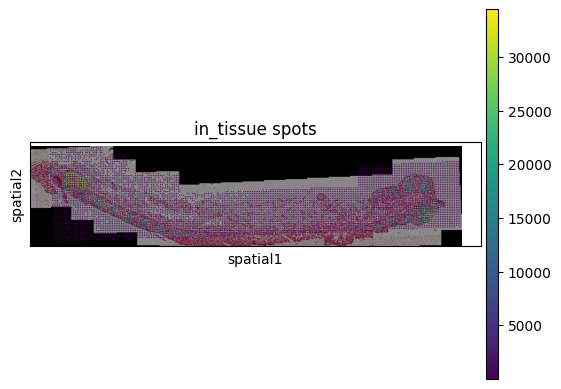

Overlay saved: /project/simmons_hts/kxu/hest/xenium_data/XeniumPR1_50um/slide1/ROI5/cell_plot.png


In [4]:
# reattach (after alignment/renames)
st.cell_adata = adata_labelled

# --- meta refresh ---
stats = refresh_meta_counts(st)
print("Before/After:", stats)

out_dir = Path("/project/simmons_hts/kxu/hest/xenium_data/XeniumPR1_50um/slide1/ROI5")
overlay_path = save_all(st, save_dir = out_dir,size=0.5)
print("Overlay saved:", overlay_path)

# XeniumPR1S1ROI6

In [5]:
# --- load data ---
exp_stem = Path("/project/simmons_hts/shared/20_11_2024_xenium_prime_run1/20241113__143534__SIMMONS_super_secret_prime_run1/output-XETG00283__0043739__Region_1__20241113__143611")
img_path = Path("/project/simmons_hts/jpark/1_project/0_xenium/RUNTRexBio/post_HnE/TIP1071_Xenium5K_post_HnE.ome.tif")
align_csv = Path("/project/simmons_hts/jpark/1_project/0_xenium/RUNTRexBio/post_HnE/TIP1071_Xenium5K_post_HnE_matrix.csv")

st = load_xenium_dataset(exp_stem, img_path, align_csv, use_dask=True, spot_size_um = 50)

Loading the WSI... (can be slow for large images)
Loading transcripts...
Pooling xenium transcripts in pseudo-visium spots...
Reading cells...


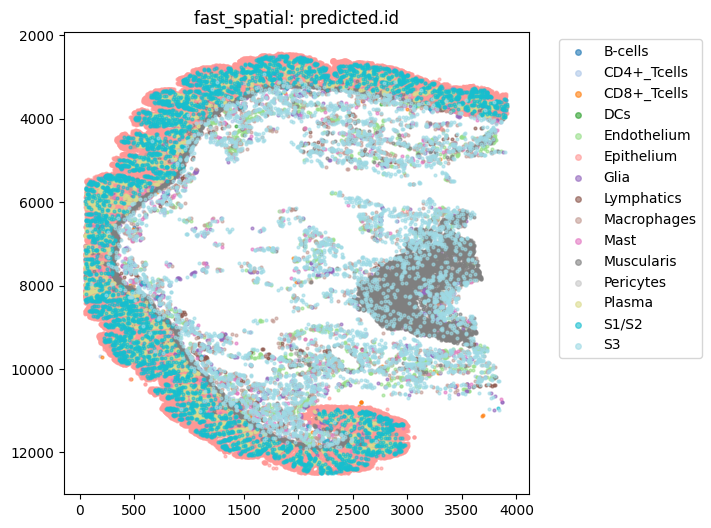

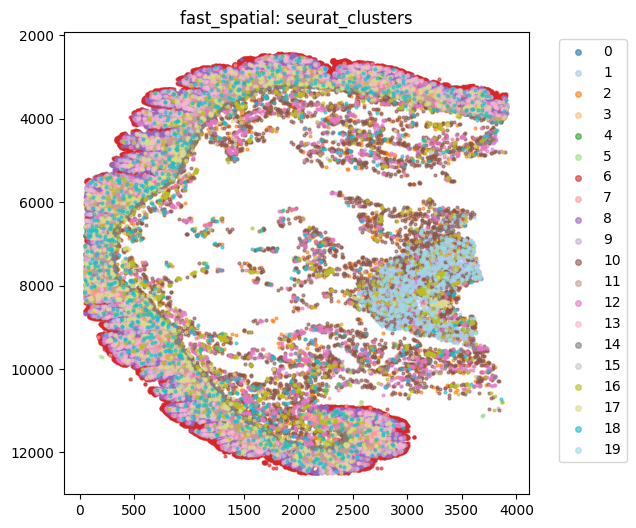

In [ ]:
# --- labelled single-cell data ---
adata_labelled = sc.read_h5ad("/project/simmons_hts/kxu/hest/xenium_labelled/h5ad/XeniumPR1S1ROI6.h5ad")

adata_labelled.obsm["spatial"] = adata_labelled.obs[["cell_centroid_x","cell_centroid_y"]].to_numpy()

fast_spatial(adata_labelled, 'predicted.id')
fast_spatial(adata_labelled, 'seurat_clusters')

# --- filter st.adata to WSI extent + drop Codeword features ---
update_st_with_filtered_and_labelled(st, adata_labelled, drop_codeword=True)

# --- align labelled cells to H&E pixel coords ---
px_um = st.meta["pixel_size"]
adata_labelled = align_labelled_to_he(adata_labelled, align_csv, pixel_size_um=px_um)

# standardize column names / annotate
adata_labelled = standardize_obs_columns(adata_labelled)
fast_spatial(adata_labelled, 'cell_type')

# --- quick sanity range of aligned coords ---
x_min, x_max, y_min, y_max = coord_range(adata_labelled.obsm["spatial"])
print(f"x:[{x_min:.1f}, {x_max:.1f}], y:[{y_min:.1f}, {y_max:.1f}]")

Before/After: {'old': {'num_cells': 1074150, 'cells_under_tissue': 1074150, 'transcripts_per_cell': 156, 'total_cell_area': 55846944.49765815}, 'new': {'num_cells': 66455, 'cells_under_tissue': 66455, 'transcripts_per_cell': 115.38504250996915, 'total_cell_area': 1103435.8068981587}}
saving to pyramidal tiff... can be slow


/home/k/kxu/.local/lib/python3.11/site-packages/hest/h5ad_reader.py:319: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


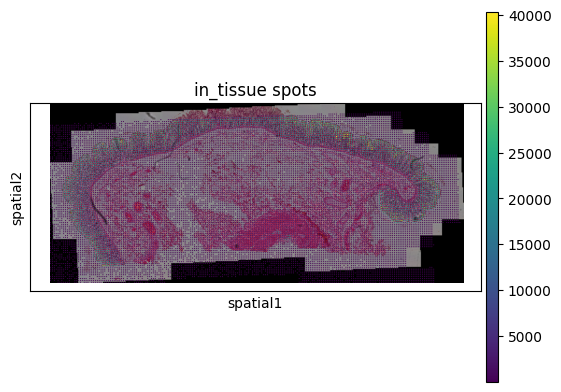

Overlay saved: /project/simmons_hts/kxu/hest/xenium_data/XeniumPR1_50um/slide1/ROI6/cell_plot.png


In [7]:
# reattach (after alignment/renames)
st.cell_adata = adata_labelled

# --- meta refresh ---
stats = refresh_meta_counts(st)
print("Before/After:", stats)

out_dir = Path("/project/simmons_hts/kxu/hest/xenium_data/XeniumPR1_50um/slide1/ROI6")
overlay_path = save_all(st, save_dir = out_dir,size=0.5)
print("Overlay saved:", overlay_path)

# XeniumPR1S1ROI7

In [2]:
# --- load data ---
exp_stem = Path("/project/simmons_hts/shared/20_11_2024_xenium_prime_run1/20241113__143534__SIMMONS_super_secret_prime_run1/output-XETG00283__0043739__Region_1__20241113__143611")
img_path = Path("/project/simmons_hts/jpark/1_project/0_xenium/RUNTRexBio/post_HnE/GI9613_Xenium5K_post_HnE.ome.tif")
align_csv = Path("/project/simmons_hts/jpark/1_project/0_xenium/RUNTRexBio/post_HnE/GI9613_Xenium5K_post_HnE_matrix.csv")

st = load_xenium_dataset(exp_stem, img_path, align_csv, use_dask=True, spot_size_um = 50)

Loading the WSI... (can be slow for large images)
Loading transcripts...
Pooling xenium transcripts in pseudo-visium spots...
Reading cells...


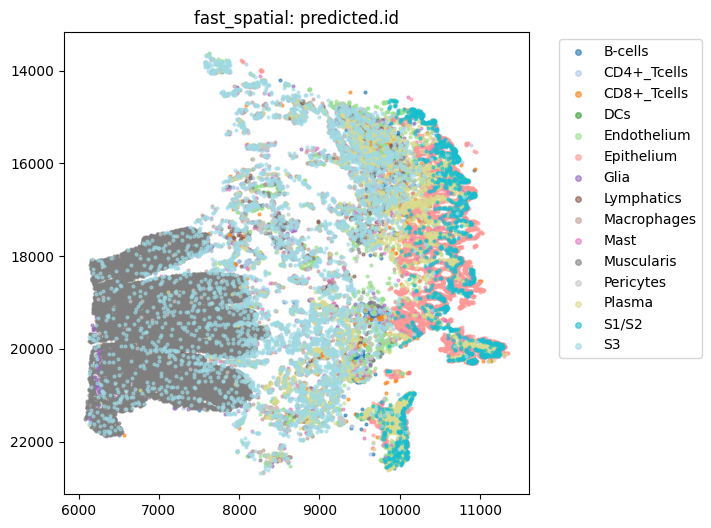

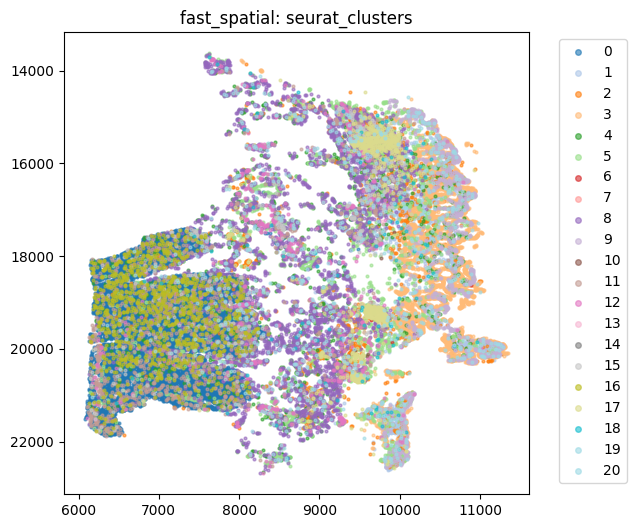

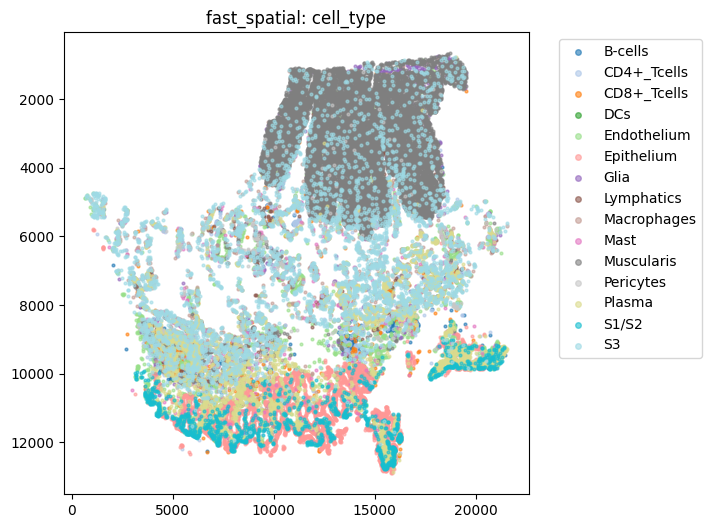

x:[643.4, 21563.5], y:[660.1, 12904.2]


In [3]:
# --- labelled single-cell data ---
adata_labelled = sc.read_h5ad("/project/simmons_hts/kxu/hest/xenium_labelled/h5ad/XeniumPR1S1ROI7.h5ad")

adata_labelled.obsm["spatial"] = adata_labelled.obs[["cell_centroid_x","cell_centroid_y"]].to_numpy()

fast_spatial(adata_labelled, 'predicted.id')
fast_spatial(adata_labelled, 'seurat_clusters')

# --- filter st.adata to WSI extent + drop Codeword features ---
update_st_with_filtered_and_labelled(st, adata_labelled, drop_codeword=True)

# --- align labelled cells to H&E pixel coords ---
px_um = st.meta["pixel_size"]
adata_labelled = align_labelled_to_he(adata_labelled, align_csv, pixel_size_um=px_um)

# standardize column names / annotate
adata_labelled = standardize_obs_columns(adata_labelled)
fast_spatial(adata_labelled, 'cell_type')

# --- quick sanity range of aligned coords ---
x_min, x_max, y_min, y_max = coord_range(adata_labelled.obsm["spatial"])
print(f"x:[{x_min:.1f}, {x_max:.1f}], y:[{y_min:.1f}, {y_max:.1f}]")

#### remove the right crack on H&E 

Spots kept after rules: 13926 / 18609


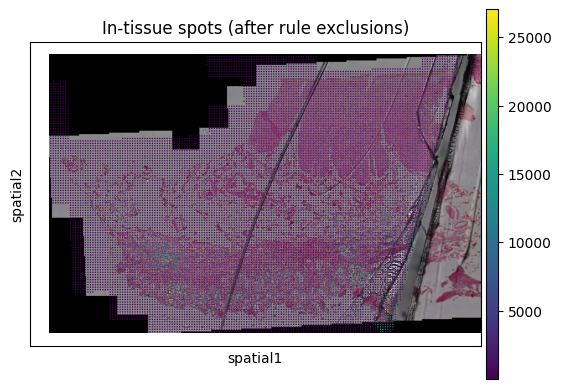

In [4]:
# --- spot exclusions across full WSI (no cell bbox restriction) ---
# get spot coords from st.adata
xy = st.adata.obsm["spatial"]
sx, sy = xy[:, 0], xy[:, 1]

# full WSI bounding box
xmin, xmax, ymin, ymax = 0, st.wsi.width, 0, st.wsi.height

# rules (edit as you like)
rules = [
    #{"type": "corner", "corner": "bottom-right", "width": 0.2, "height": 0.48, "units": "frac"}
    {'type': 'trapezoid','orientation': 'top','top_width': 0.33,'bottom_width': 0.61,'center_offset': 0.5,'height': 1,'units': 'frac'}
]

# apply rule-based exclusions directly
final_keep = apply_spot_exclusions(sx, sy, (xmin, xmax, ymin, ymax), rules)

print(f"Spots kept after rules: {final_keep.sum()} / {len(final_keep)}")

# visualize with scanpy
sc.pl.spatial(
    st.adata[final_keep],
    size = 0.5, 
    img_key="downscaled_fullres",
    color="total_counts",
    title="In-tissue spots (after rule exclusions)",
)

Before/After: {'old': {'num_cells': 1074150, 'cells_under_tissue': 1074150, 'transcripts_per_cell': 156, 'total_cell_area': 55846944.49765815}, 'new': {'num_cells': 39354, 'cells_under_tissue': 39354, 'transcripts_per_cell': 76.94305534380241, 'total_cell_area': 611439.9356792163}}
saving to pyramidal tiff... can be slow


/home/k/kxu/.local/lib/python3.11/site-packages/hest/h5ad_reader.py:319: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


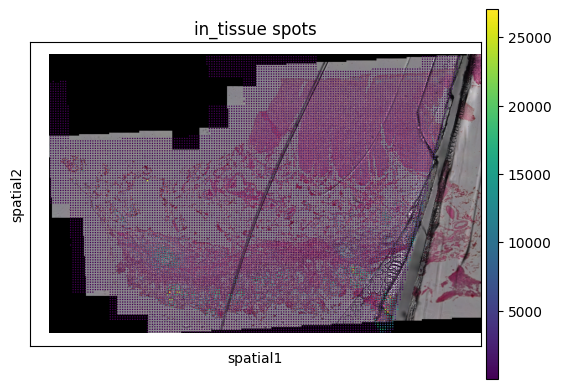

Overlay saved: /project/simmons_hts/kxu/hest/xenium_data/XeniumPR1_50um/slide1/ROI7/cell_plot.png


In [5]:
# reattach (after alignment/renames)
st.adata = st.adata[final_keep]
st.cell_adata = adata_labelled

# --- meta refresh ---
stats = refresh_meta_counts(st)
print("Before/After:", stats)

out_dir = Path("/project/simmons_hts/kxu/hest/xenium_data/XeniumPR1_50um/slide1/ROI7")
overlay_path = save_all(st, out_dir, pyramidal=True,size=0.5)
print("Overlay saved:", overlay_path)

# XeniumPR1S1ROI8

In [15]:
# --- load data ---
exp_stem = Path("/project/simmons_hts/shared/20_11_2024_xenium_prime_run1/20241113__143534__SIMMONS_super_secret_prime_run1/output-XETG00283__0043739__Region_1__20241113__143611")
img_path  = Path(f"/project/simmons_hts/jpark/1_project/0_xenium/RUNTRexBio/post_HnE/OX932_stitched.ome.ome.tif")
align_csv = Path(f"/project/simmons_hts/jpark/1_project/0_xenium/RUNTRexBio/post_HnE/OX932_stitched.ome_matrix.csv")

st = load_xenium_dataset(exp_stem, img_path, align_csv, use_dask=True, spot_size_um = 50)

NameError: name 'load_xenium_dataset' is not defined

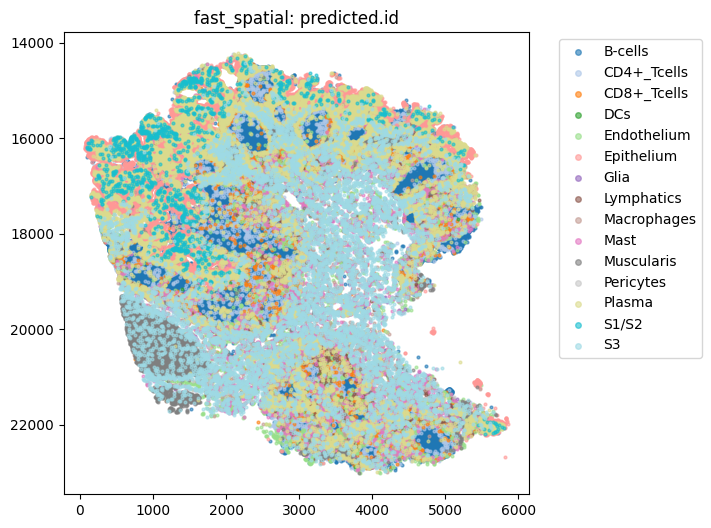

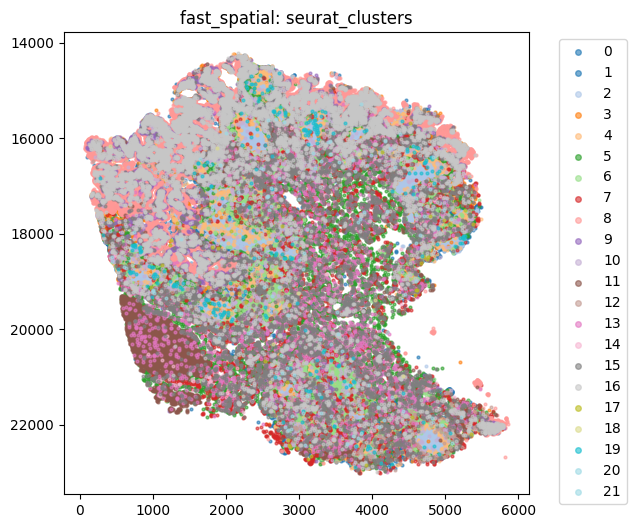

In [ ]:
# --- labelled single-cell data ---
adata_labelled = sc.read_h5ad("/project/simmons_hts/kxu/hest/xenium_labelled/h5ad/XeniumPR1S1ROI8.h5ad")

adata_labelled.obsm["spatial"] = adata_labelled.obs[["cell_centroid_x","cell_centroid_y"]].to_numpy()

fast_spatial(adata_labelled, 'predicted.id')
fast_spatial(adata_labelled, 'seurat_clusters')

# --- filter st.adata to WSI extent + drop Codeword features ---
update_st_with_filtered_and_labelled(st, adata_labelled, drop_codeword=True)

# --- align labelled cells to H&E pixel coords ---
px_um = st.meta["pixel_size"]
adata_labelled = align_labelled_to_he(adata_labelled, align_csv, pixel_size_um=px_um)

# standardize column names / annotate
adata_labelled = standardize_obs_columns(adata_labelled)
fast_spatial(adata_labelled, 'cell_type')

# --- quick sanity range of aligned coords ---
x_min, x_max, y_min, y_max = coord_range(adata_labelled.obsm["spatial"])
print(f"x:[{x_min:.1f}, {x_max:.1f}], y:[{y_min:.1f}, {y_max:.1f}]")

Before/After: {'old': {'num_cells': 1074150, 'cells_under_tissue': 1074150, 'transcripts_per_cell': 156, 'total_cell_area': 55846944.49765815}, 'new': {'num_cells': 141857, 'cells_under_tissue': 141857, 'transcripts_per_cell': 108.0582769972578, 'total_cell_area': 2390081.5213944633}}
saving to pyramidal tiff... can be slow


/home/k/kxu/.local/lib/python3.11/site-packages/hest/h5ad_reader.py:319: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


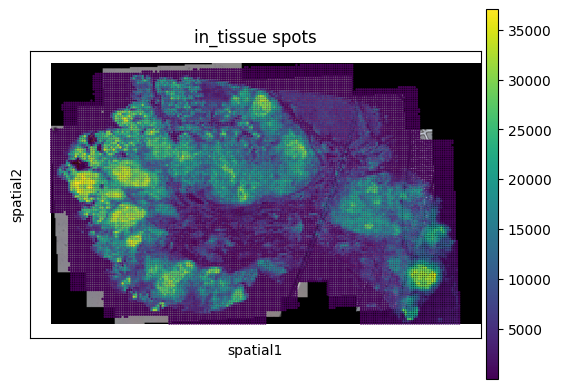

Overlay saved: /project/simmons_hts/kxu/hest/xenium_data/XeniumPR1_50um/slide1/ROI8/cell_plot.png


In [13]:
# reattach (after alignment/renames)
st.cell_adata = adata_labelled

# --- meta refresh ---
stats = refresh_meta_counts(st)
print("Before/After:", stats)

out_dir = Path("/project/simmons_hts/kxu/hest/xenium_data/XeniumPR1_50um/slide1/ROI8")
overlay_path = save_all(st, out_dir, pyramidal=True)
print("Overlay saved:", overlay_path,size=0.5)

# XeniumPR1S2ROI1

In [18]:
# only change sample ID once here
sample_id = "CAM005"
# exp_stem needs to be changed for slide 2
exp_stem = Path("/project/simmons_hts/shared/20_11_2024_xenium_prime_run1/20241113__143534__SIMMONS_super_secret_prime_run1/output-XETG00283__0043720__Region_1__20241113__143611")
img_path  = Path(f"/project/simmons_hts/jpark/1_project/0_xenium/RUNTRexBio/post_HnE/{sample_id}_Xenium5K_post_HnE.ome.tif")
align_csv = Path(f"/project/simmons_hts/jpark/1_project/0_xenium/RUNTRexBio/post_HnE/{sample_id}_Xenium5K_post_HnE_matrix.csv")
st = load_xenium_dataset(exp_stem, img_path, align_csv, use_dask=True, spot_size_um = 50)

Loading the WSI... (can be slow for large images)
Loading transcripts...
Pooling xenium transcripts in pseudo-visium spots...
Reading cells...


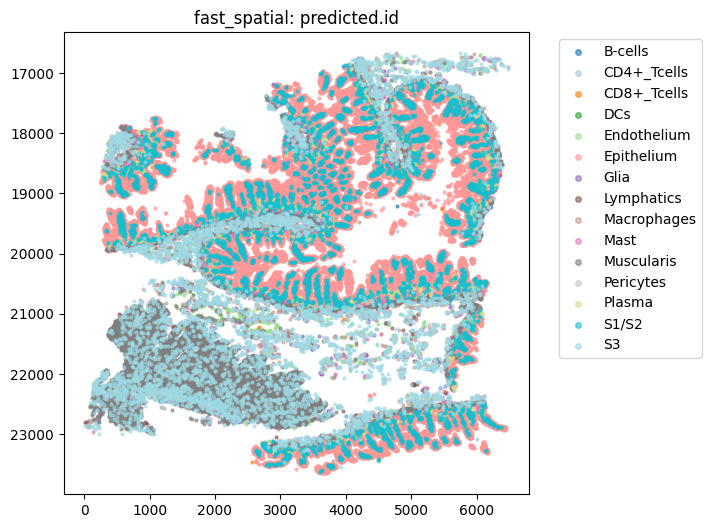

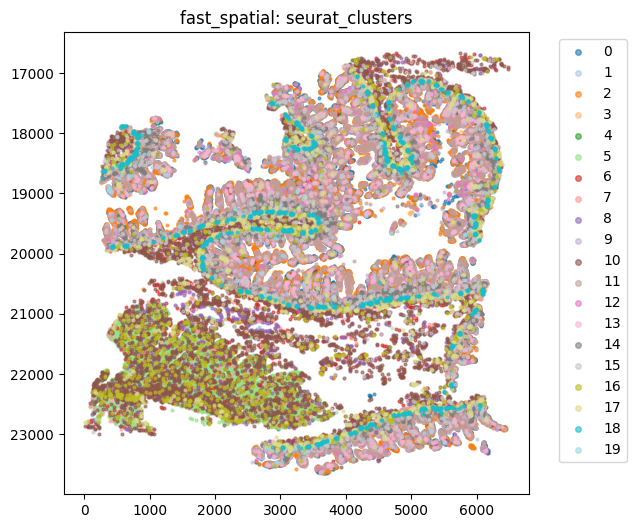

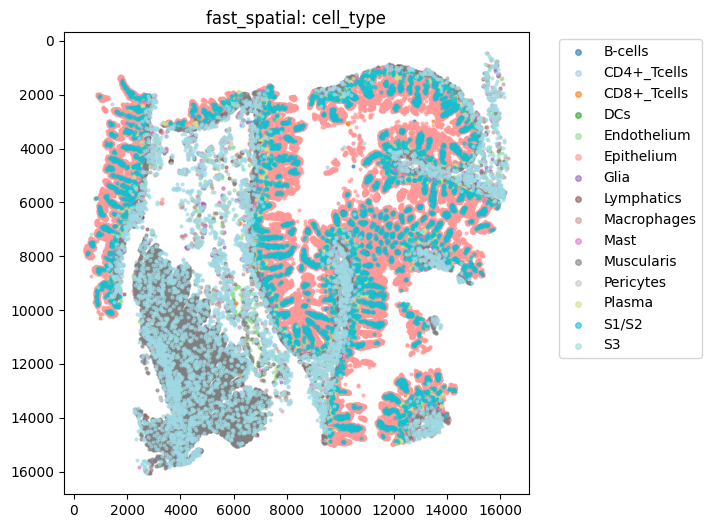

x:[410.4, 16280.8], y:[460.5, 16065.6]


In [20]:
# --- labelled single-cell data ---
adata_labelled = sc.read_h5ad("/project/simmons_hts/kxu/hest/xenium_labelled/h5ad/XeniumPR1S2ROI1.h5ad")

adata_labelled.obsm["spatial"] = adata_labelled.obs[["cell_centroid_x","cell_centroid_y"]].to_numpy()

fast_spatial(adata_labelled, 'predicted.id')
fast_spatial(adata_labelled, 'seurat_clusters')

# --- filter st.adata to WSI extent + drop Codeword features ---
update_st_with_filtered_and_labelled(st, adata_labelled, drop_codeword=True)

# --- align labelled cells to H&E pixel coords ---
px_um = st.meta["pixel_size"]
adata_labelled = align_labelled_to_he(adata_labelled, align_csv, pixel_size_um=px_um)

# standardize column names / annotate
adata_labelled = standardize_obs_columns(adata_labelled)
fast_spatial(adata_labelled, 'cell_type')

# --- quick sanity range of aligned coords ---
x_min, x_max, y_min, y_max = coord_range(adata_labelled.obsm["spatial"])
print(f"x:[{x_min:.1f}, {x_max:.1f}], y:[{y_min:.1f}, {y_max:.1f}]")

Spots kept after rules: 17263 / 18101


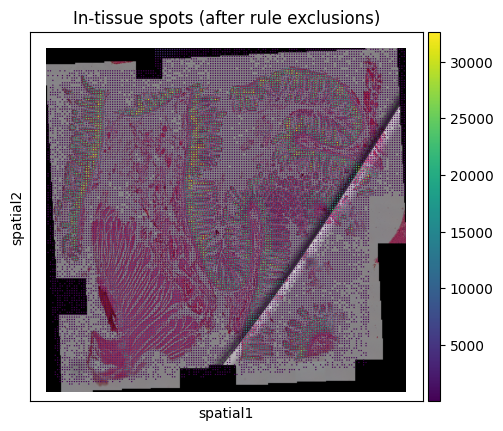

In [23]:
# --- spot exclusions across full WSI (no cell bbox restriction) ---

# get spot coords from st.adata
xy = st.adata.obsm["spatial"]
sx, sy = xy[:, 0], xy[:, 1]

# full WSI bounding box
xmin, xmax, ymin, ymax = 0, st.wsi.width, 0, st.wsi.height

# rules (edit as you like)
rules = [
    {"type": "corner", "corner": "bottom-right", "width": 0.1, "height": 0.57, "units": "frac"},
    {"type": "corner", "corner": "top-left", "width": 0.3, "height": 0.06, "units": "frac"}
]

# apply rule-based exclusions directly
final_keep = apply_spot_exclusions(sx, sy, (xmin, xmax, ymin, ymax), rules)

print(f"Spots kept after rules: {final_keep.sum()} / {len(final_keep)}")

# visualize with scanpy
sc.pl.spatial(
    st.adata[final_keep],
    size = 0.5,
    img_key="downscaled_fullres",
    color="total_counts",
    title="In-tissue spots (after rule exclusions)",
)

Before/After: {'old': {'num_cells': 1090005, 'cells_under_tissue': 1090005, 'transcripts_per_cell': 140, 'total_cell_area': 53266916.81791191}, 'new': {'num_cells': 83080, 'cells_under_tissue': 83080, 'transcripts_per_cell': 115.78176456427539, 'total_cell_area': 1373153.8742773067}}
saving to pyramidal tiff... can be slow


/home/k/kxu/.local/lib/python3.11/site-packages/hest/h5ad_reader.py:319: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


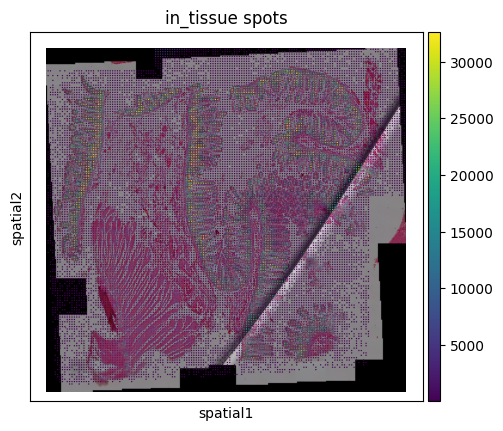

Overlay saved: /project/simmons_hts/kxu/hest/xenium_data/XeniumPR1_50um/slide2/ROI1/cell_plot.png


In [24]:
# reattach (after alignment/renames)
st.adata = st.adata[final_keep] # only when confirmed bounding box
st.cell_adata = adata_labelled

# --- meta refresh ---
stats = refresh_meta_counts(st)
print("Before/After:", stats)

out_dir = Path("/project/simmons_hts/kxu/hest/xenium_data/XeniumPR1_50um/slide2/ROI1")
overlay_path = save_all(st, out_dir, pyramidal=True,size=0.5)
print("Overlay saved:", overlay_path)

# XeniumPR1S2ROI2

In [25]:
# only change sample ID once here
sample_id = "GI9662"
exp_stem = Path("/project/simmons_hts/shared/20_11_2024_xenium_prime_run1/20241113__143534__SIMMONS_super_secret_prime_run1/output-XETG00283__0043720__Region_1__20241113__143611")
img_path  = Path(f"/project/simmons_hts/jpark/1_project/0_xenium/RUNTRexBio/post_HnE/{sample_id}_Xenium5K_post_HnE.ome.tif")
align_csv = Path(f"/project/simmons_hts/jpark/1_project/0_xenium/RUNTRexBio/post_HnE/{sample_id}_Xenium5K_post_HnE_matrix.csv")
st = load_xenium_dataset(exp_stem, img_path, align_csv, use_dask=True, spot_size_um = 50)

Loading the WSI... (can be slow for large images)
Loading transcripts...
Pooling xenium transcripts in pseudo-visium spots...
Reading cells...


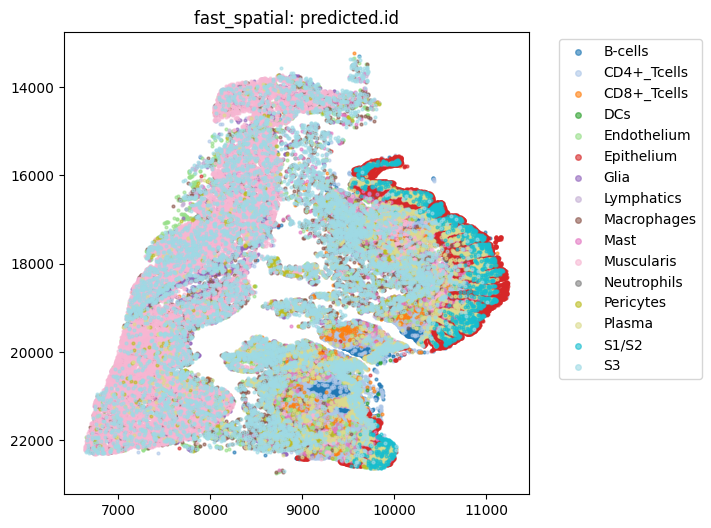

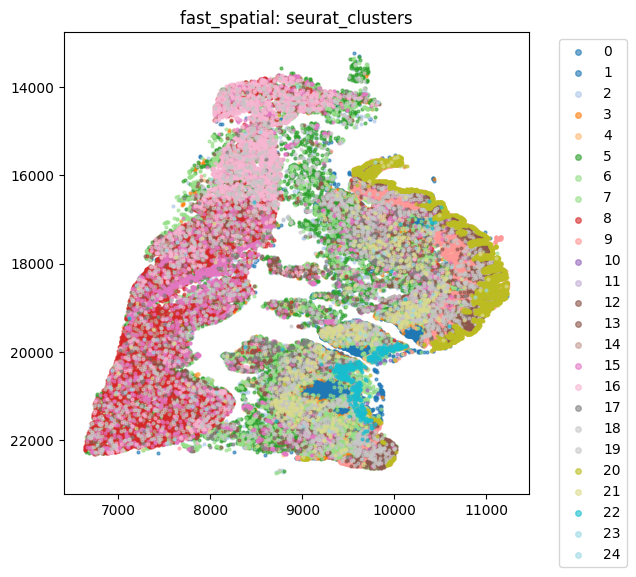

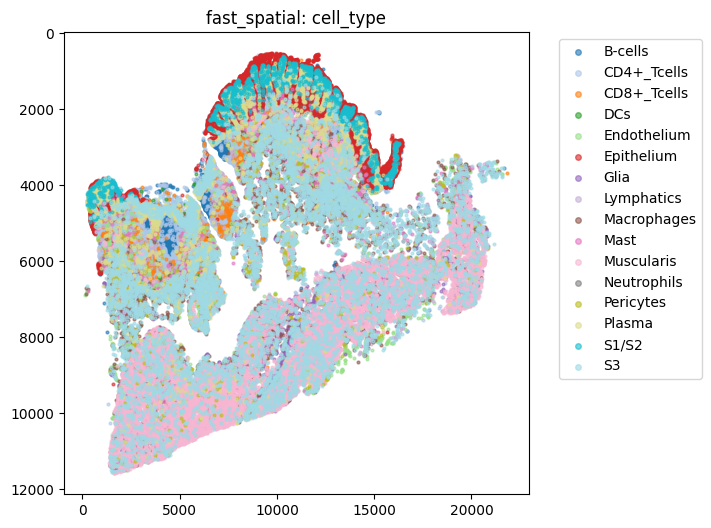

x:[116.4, 21854.5], y:[531.6, 11577.2]


In [26]:
# --- labelled single-cell data ---
adata_labelled = sc.read_h5ad("/project/simmons_hts/kxu/hest/xenium_labelled/h5ad/XeniumPR1S2ROI2.h5ad")

adata_labelled.obsm["spatial"] = adata_labelled.obs[["cell_centroid_x","cell_centroid_y"]].to_numpy()

fast_spatial(adata_labelled, 'predicted.id')
fast_spatial(adata_labelled, 'seurat_clusters')

# --- filter st.adata to WSI extent + drop Codeword features ---
update_st_with_filtered_and_labelled(st, adata_labelled, drop_codeword=True)

# --- align labelled cells to H&E pixel coords ---
px_um = st.meta["pixel_size"]
adata_labelled = align_labelled_to_he(adata_labelled, align_csv, pixel_size_um=px_um)

# standardize column names / annotate
adata_labelled = standardize_obs_columns(adata_labelled)
fast_spatial(adata_labelled, 'cell_type')

# --- quick sanity range of aligned coords ---
x_min, x_max, y_min, y_max = coord_range(adata_labelled.obsm["spatial"])
print(f"x:[{x_min:.1f}, {x_max:.1f}], y:[{y_min:.1f}, {y_max:.1f}]")

Spots kept after rules: 14819 / 14929


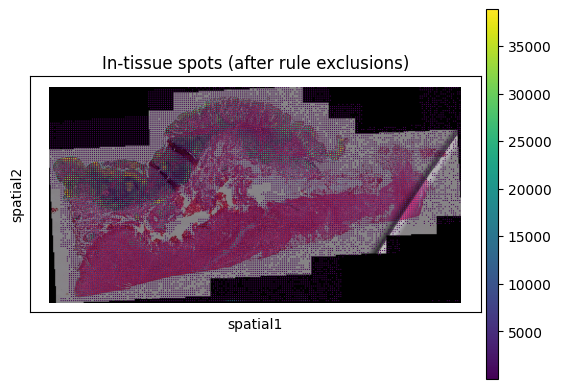

In [30]:
# --- spot exclusions across full WSI (no cell bbox restriction) ---

# get spot coords from st.adata
xy = st.adata.obsm["spatial"]
sx, sy = xy[:, 0], xy[:, 1]

# full WSI bounding box
xmin, xmax, ymin, ymax = 0, st.wsi.width, 0, st.wsi.height

# rules (edit as you like)
rules = [
    {"type": "corner", "corner": "bottom-left", "width": 0.03, "height": 0.53, "units": "frac"},
]

# apply rule-based exclusions directly
final_keep = apply_spot_exclusions(sx, sy, (xmin, xmax, ymin, ymax), rules)

print(f"Spots kept after rules: {final_keep.sum()} / {len(final_keep)}")

# visualize with scanpy
sc.pl.spatial(
    st.adata[final_keep],
    size = 0.5,
    img_key="downscaled_fullres",
    color="total_counts",
    title="In-tissue spots (after rule exclusions)",
)

Before/After: {'old': {'num_cells': 1090005, 'cells_under_tissue': 1090005, 'transcripts_per_cell': 140, 'total_cell_area': 53266916.81791191}, 'new': {'num_cells': 89095, 'cells_under_tissue': 89095, 'transcripts_per_cell': 109.40207643526573, 'total_cell_area': 1461562.246875331}}
saving to pyramidal tiff... can be slow


/home/k/kxu/.local/lib/python3.11/site-packages/hest/h5ad_reader.py:319: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


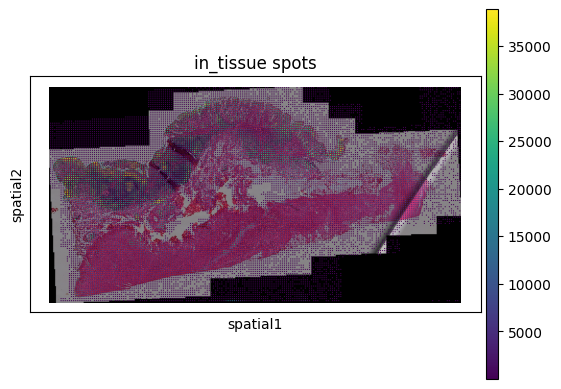

Overlay saved: /project/simmons_hts/kxu/hest/xenium_data/XeniumPR1_50um/slide2/ROI2/cell_plot.png


In [31]:
# reattach (after alignment/renames)
st.adata = st.adata[final_keep]
st.cell_adata = adata_labelled

# --- meta refresh ---
stats = refresh_meta_counts(st)
print("Before/After:", stats)

out_dir = Path("/project/simmons_hts/kxu/hest/xenium_data/XeniumPR1_50um/slide2/ROI2")
overlay_path = save_all(st, out_dir, pyramidal=True, size=0.5)
print("Overlay saved:", overlay_path)

# XeniumPR1S3ROI3

In [2]:
# only change sample ID once here
sample_id = "GI7051"
exp_stem = Path("/project/simmons_hts/shared/20_11_2024_xenium_prime_run1/20241113__143534__SIMMONS_super_secret_prime_run1/output-XETG00283__0043720__Region_1__20241113__143611")
img_path  = Path(f"/project/simmons_hts/jpark/1_project/0_xenium/RUNTRexBio/post_HnE/{sample_id}_Xenium5K_post_HnE.ome.tif")
align_csv = Path(f"/project/simmons_hts/jpark/1_project/0_xenium/RUNTRexBio/post_HnE/{sample_id}_Xenium5K_post_HnE_matrix.csv")
st = load_xenium_dataset(exp_stem, img_path, align_csv, use_dask=True, spot_size_um = 50)

Loading the WSI... (can be slow for large images)
Loading transcripts...
Pooling xenium transcripts in pseudo-visium spots...


/package/python-cbrg/current/3.11.3/lib/python3.11/site-packages/anndata/_core/anndata.py:1105: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):


Reading cells...


/package/python-cbrg/current/3.11.3/lib/python3.11/site-packages/anndata/_core/anndata.py:1105: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):


In [3]:
# --- labelled single-cell data ---
adata_labelled = sc.read_h5ad("/project/simmons_hts/kxu/hest/xenium_labelled/h5ad/XeniumPR1S2ROI3.h5ad")

adata_labelled.obsm["spatial"] = adata_labelled.obs[["cell_centroid_x","cell_centroid_y"]].to_numpy()

#fast_spatial(adata_labelled, 'predicted.id')
#fast_spatial(adata_labelled, 'seurat_clusters')

# --- filter st.adata to WSI extent + drop Codeword features ---
update_st_with_filtered_and_labelled(st, adata_labelled, drop_codeword=True)

# --- align labelled cells to H&E pixel coords ---
px_um = st.meta["pixel_size"]
adata_labelled = align_labelled_to_he(adata_labelled, align_csv, pixel_size_um=px_um)

# standardize column names / annotate
adata_labelled = standardize_obs_columns(adata_labelled)
#fast_spatial(adata_labelled, 'cell_type')

# --- quick sanity range of aligned coords ---
x_min, x_max, y_min, y_max = coord_range(adata_labelled.obsm["spatial"])
print(f"x:[{x_min:.1f}, {x_max:.1f}], y:[{y_min:.1f}, {y_max:.1f}]")

/package/python-cbrg/current/3.11.3/lib/python3.11/site-packages/anndata/_core/anndata.py:1105: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):


x:[896.6, 13942.0], y:[1069.7, 11808.6]


Spots kept after rules: 9534 / 10783


/package/python-cbrg/current/3.11.3/lib/python3.11/site-packages/anndata/_core/anndata.py:1105: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):
/tmp/ipykernel_4130987/113463602.py:22: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  sc.pl.spatial(


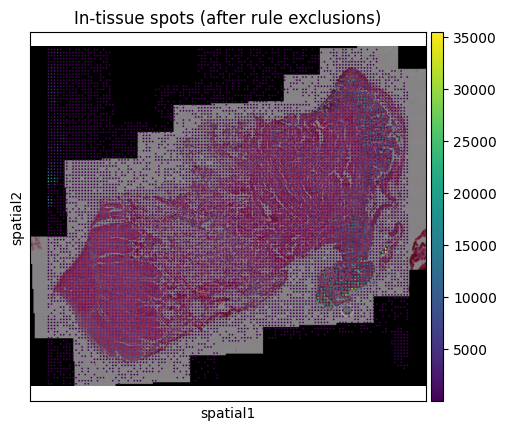

In [4]:
# --- spot exclusions across full WSI ---

# get spot coords from st.adata
xy = st.adata.obsm["spatial"]
sx, sy = xy[:, 0], xy[:, 1]

# full WSI bounding box
xmin, xmax, ymin, ymax = 0, st.wsi.width, 0, st.wsi.height

# rules (edit as you like)
rules = [
    {"type": "strip", "side": "right", "size": 0.09, "units": "frac"},
    {"type": "strip", "side": "left", "size": 0.04, "units": "frac"}
]

# apply rule-based exclusions directly
final_keep = apply_spot_exclusions(sx, sy, (xmin, xmax, ymin, ymax), rules)

print(f"Spots kept after rules: {final_keep.sum()} / {len(final_keep)}")

# visualize with scanpy
sc.pl.spatial(
    st.adata[final_keep],
    size = 0.5,
    img_key="downscaled_fullres",
    color="total_counts",
    title="In-tissue spots (after rule exclusions)",
)

In [ ]:
# reattach (after alignment/renames)
st.adata = st.adata[final_keep]
st.cell_adata = adata_labelled

# --- meta refresh ---
stats = refresh_meta_counts(st)
print("Before/After:", stats)

out_dir = Path("/project/simmons_hts/kxu/hest/xenium_data/XeniumPR1_50um/slide2/ROI3")
overlay_path = save_all(st, out_dir, pyramidal=True, size=0.5)
print("Overlay saved:", overlay_path)

Before/After: {'old': {'num_cells': 1090005, 'cells_under_tissue': 1090005, 'transcripts_per_cell': 140, 'total_cell_area': 53266916.81791191}, 'new': {'num_cells': 27162, 'cells_under_tissue': 27162, 'transcripts_per_cell': 88.31967454532067, 'total_cell_area': 432808.7755936795}}


/home/k/kxu/.local/lib/python3.11/site-packages/hest/HESTData.py:1390: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  fig = sc.pl.spatial(adata, show=False, img_key="downscaled_fullres", color=[key], title=f"in_tissue spots", return_fig=True, **pl_kwargs)


saving to pyramidal tiff... can be slow


/home/k/kxu/.local/lib/python3.11/site-packages/hest/h5ad_reader.py:319: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


# XeniumPR1S2ROI4

In [6]:
# only change sample ID once here
sample_id = "GI6966"
exp_stem = Path("/project/simmons_hts/shared/20_11_2024_xenium_prime_run1/20241113__143534__SIMMONS_super_secret_prime_run1/output-XETG00283__0043720__Region_1__20241113__143611")
img_path  = Path(f"/project/simmons_hts/jpark/1_project/0_xenium/RUNTRexBio/post_HnE/{sample_id}_Xenium5K_post_HnE.ome.tif")
align_csv = Path(f"/project/simmons_hts/jpark/1_project/0_xenium/RUNTRexBio/post_HnE/{sample_id}_Xenium5K_post_HnE_matrix.csv")
st = load_xenium_dataset(exp_stem, img_path, align_csv, use_dask=True, spot_size_um = 50)

Loading the WSI... (can be slow for large images)
Loading transcripts...
Pooling xenium transcripts in pseudo-visium spots...


/package/python-cbrg/current/3.11.3/lib/python3.11/site-packages/anndata/_core/anndata.py:1105: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):


Reading cells...


/package/python-cbrg/current/3.11.3/lib/python3.11/site-packages/anndata/_core/anndata.py:1105: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):


In [7]:
# --- labelled single-cell data ---
adata_labelled = sc.read_h5ad("/project/simmons_hts/kxu/hest/xenium_labelled/h5ad/XeniumPR1S2ROI4.h5ad")

adata_labelled.obsm["spatial"] = adata_labelled.obs[["cell_centroid_x","cell_centroid_y"]].to_numpy()

#fast_spatial(adata_labelled, 'predicted.id')
#fast_spatial(adata_labelled, 'seurat_clusters')

# --- filter st.adata to WSI extent + drop Codeword features ---
update_st_with_filtered_and_labelled(st, adata_labelled, drop_codeword=True)

# --- align labelled cells to H&E pixel coords ---
px_um = st.meta["pixel_size"]
adata_labelled = align_labelled_to_he(adata_labelled, align_csv, pixel_size_um=px_um)

# standardize column names / annotate
adata_labelled = standardize_obs_columns(adata_labelled)
#fast_spatial(adata_labelled, 'cell_type')

/package/python-cbrg/current/3.11.3/lib/python3.11/site-packages/anndata/_core/anndata.py:1105: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):


Spots kept after rules: 15499 / 16582


/package/python-cbrg/current/3.11.3/lib/python3.11/site-packages/anndata/_core/anndata.py:1105: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):
/tmp/ipykernel_4130987/1836559224.py:21: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  sc.pl.spatial(


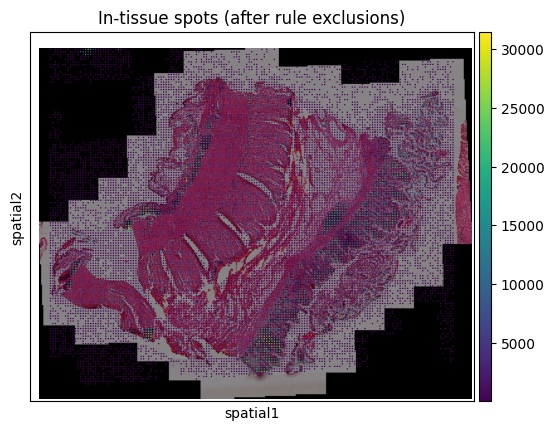

In [8]:
# --- spot exclusions across full WSI ---
# get spot coords from st.adata
xy = st.adata.obsm["spatial"]
sx, sy = xy[:, 0], xy[:, 1]

# full WSI bounding box
xmin, xmax, ymin, ymax = 0, st.wsi.width, 0, st.wsi.height

# rules (edit as you like)
rules = [
    {"type": "strip", "side": "right", "size": 0.04, "units": "frac"},
    {"type": "strip", "side": "left", "size": 0.02, "units": "frac"}
]

# apply rule-based exclusions directly
final_keep = apply_spot_exclusions(sx, sy, (xmin, xmax, ymin, ymax), rules)

print(f"Spots kept after rules: {final_keep.sum()} / {len(final_keep)}")

# visualize with scanpy
sc.pl.spatial(
    st.adata[final_keep],
    size = 0.5,
    img_key="downscaled_fullres",
    color="total_counts",
    title="In-tissue spots (after rule exclusions)",
)

Before/After: {'old': {'num_cells': 1090005, 'cells_under_tissue': 1090005, 'transcripts_per_cell': 140, 'total_cell_area': 53266916.81791191}, 'new': {'num_cells': 47925, 'cells_under_tissue': 47925, 'transcripts_per_cell': 86.23106937923839, 'total_cell_area': 766544.4972244431}}


/home/k/kxu/.local/lib/python3.11/site-packages/hest/HESTData.py:1390: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  fig = sc.pl.spatial(adata, show=False, img_key="downscaled_fullres", color=[key], title=f"in_tissue spots", return_fig=True, **pl_kwargs)


saving to pyramidal tiff... can be slow


/home/k/kxu/.local/lib/python3.11/site-packages/hest/h5ad_reader.py:319: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


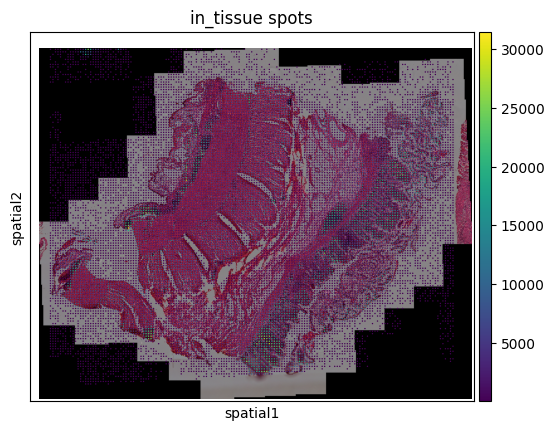

Overlay saved: /project/simmons_hts/kxu/hest/xenium_data/XeniumPR1_50um/slide2/ROI4/cell_plot.png


In [9]:
# reattach (after alignment/renames)
st.adata = st.adata[final_keep]
st.cell_adata = adata_labelled

# --- meta refresh ---
stats = refresh_meta_counts(st)
print("Before/After:", stats)

out_dir = Path("/project/simmons_hts/kxu/hest/xenium_data/XeniumPR1_50um/slide2/ROI4")
overlay_path = save_all(st, out_dir, pyramidal=True, size = 0.5)
print("Overlay saved:", overlay_path)

# XeniumPR1S2ROI5

In [40]:
# only change sample ID once here
sample_id = "TIP522"
exp_stem = Path("/project/simmons_hts/shared/20_11_2024_xenium_prime_run1/20241113__143534__SIMMONS_super_secret_prime_run1/output-XETG00283__0043720__Region_1__20241113__143611")
img_path  = Path(f"/project/simmons_hts/jpark/1_project/0_xenium/RUNTRexBio/post_HnE/{sample_id}_Xenium5K_post_HnE.ome.tif")
align_csv = Path(f"/project/simmons_hts/jpark/1_project/0_xenium/RUNTRexBio/post_HnE/{sample_id}_Xenium5K_post_HnE_matrix.csv")
st = load_xenium_dataset(exp_stem, img_path, align_csv, use_dask=True, spot_size_um = 50)

Loading the WSI... (can be slow for large images)
Loading transcripts...
Pooling xenium transcripts in pseudo-visium spots...
Reading cells...


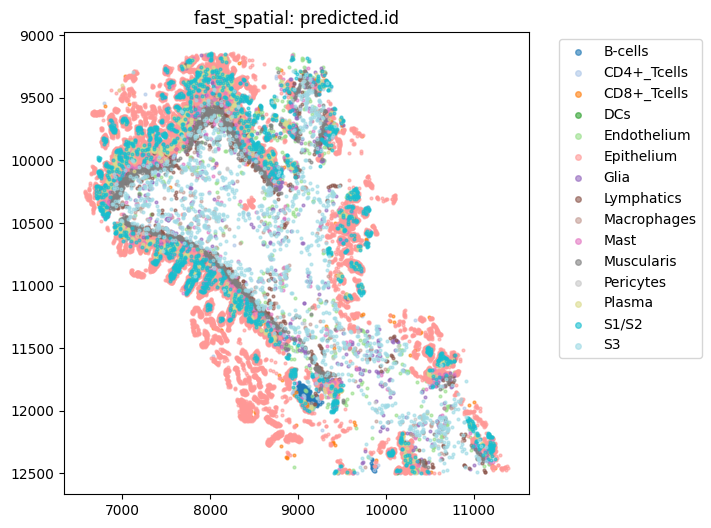

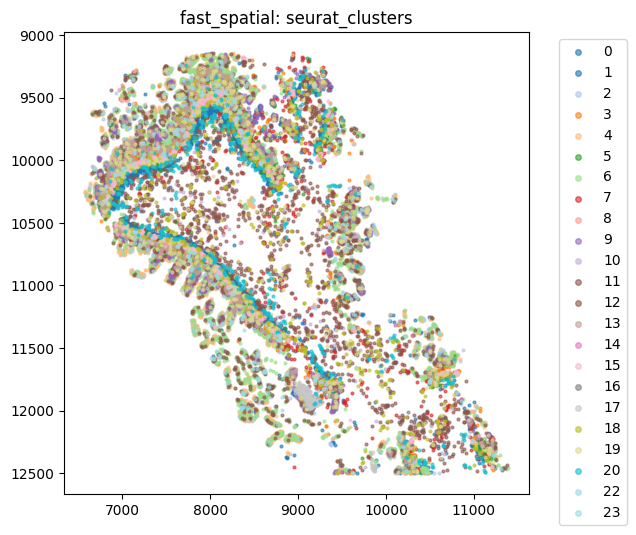

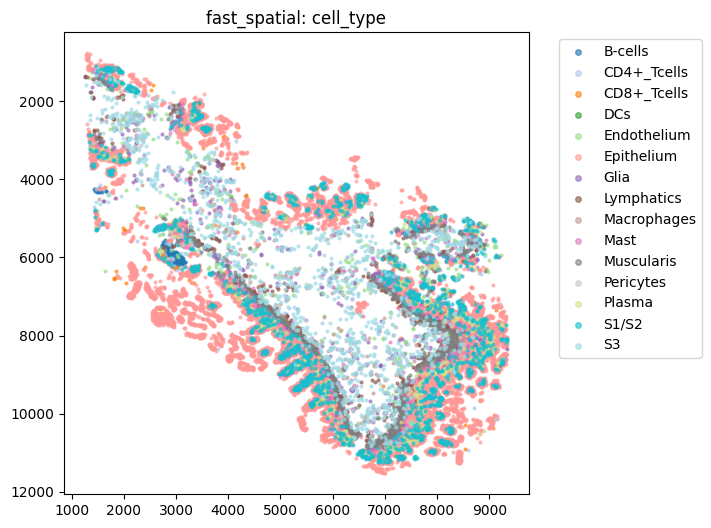

In [41]:
# --- labelled single-cell data ---
adata_labelled = sc.read_h5ad("/project/simmons_hts/kxu/hest/xenium_labelled/h5ad/XeniumPR1S2ROI5.h5ad")

adata_labelled.obsm["spatial"] = adata_labelled.obs[["cell_centroid_x","cell_centroid_y"]].to_numpy()

fast_spatial(adata_labelled, 'predicted.id')
fast_spatial(adata_labelled, 'seurat_clusters')

# --- filter st.adata to WSI extent + drop Codeword features ---
update_st_with_filtered_and_labelled(st, adata_labelled, drop_codeword=True)

# --- align labelled cells to H&E pixel coords ---
px_um = st.meta["pixel_size"]
adata_labelled = align_labelled_to_he(adata_labelled, align_csv, pixel_size_um=px_um)

# standardize column names / annotate
adata_labelled = standardize_obs_columns(adata_labelled)
fast_spatial(adata_labelled, 'cell_type')

Before/After: {'old': {'num_cells': 1090005, 'cells_under_tissue': 1090005, 'transcripts_per_cell': 140, 'total_cell_area': 53266916.81791191}, 'new': {'num_cells': 21234, 'cells_under_tissue': 21234, 'transcripts_per_cell': 123.94358104926062, 'total_cell_area': 353326.6052291087}}
saving to pyramidal tiff... can be slow


/home/k/kxu/.local/lib/python3.11/site-packages/hest/h5ad_reader.py:319: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


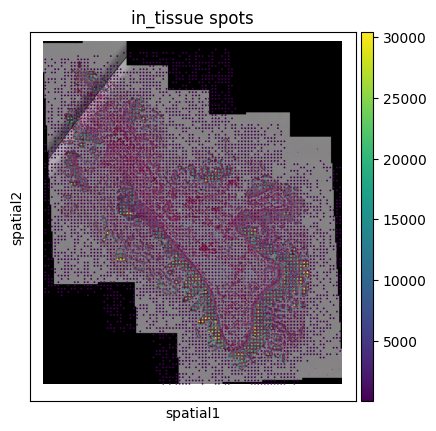

Overlay saved: /project/simmons_hts/kxu/hest/xenium_data/XeniumPR1_50um/slide2/ROI5/cell_plot.png


In [42]:
# reattach (after alignment/renames)
st.cell_adata = adata_labelled

# --- meta refresh ---
stats = refresh_meta_counts(st)
print("Before/After:", stats)

out_dir = Path("/project/simmons_hts/kxu/hest/xenium_data/XeniumPR1_50um/slide2/ROI5")
overlay_path = save_all(st, out_dir, pyramidal=True,size=0.5)
print("Overlay saved:", overlay_path)

# XeniumPR1S2ROI6

In [2]:
# only change sample ID once here
sample_id = "TIP815"
exp_stem = Path("/project/simmons_hts/shared/20_11_2024_xenium_prime_run1/20241113__143534__SIMMONS_super_secret_prime_run1/output-XETG00283__0043720__Region_1__20241113__143611")
img_path  = Path(f"/project/simmons_hts/jpark/1_project/0_xenium/RUNTRexBio/post_HnE/{sample_id}_Xenium5K_post_HnE.ome.tif")
align_csv = Path(f"/project/simmons_hts/jpark/1_project/0_xenium/RUNTRexBio/post_HnE/{sample_id}_Xenium5K_post_HnE_matrix.csv")
st = load_xenium_dataset(exp_stem, img_path, align_csv, use_dask=True, spot_size_um = 50)

Loading the WSI... (can be slow for large images)
Loading transcripts...
Pooling xenium transcripts in pseudo-visium spots...
Reading cells...


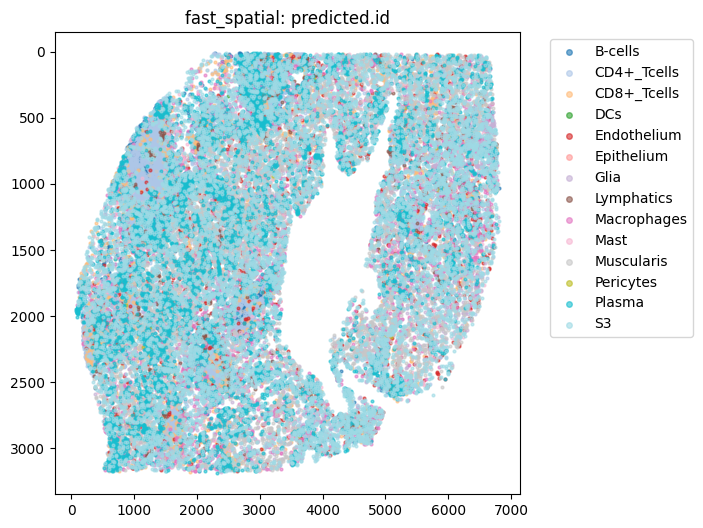

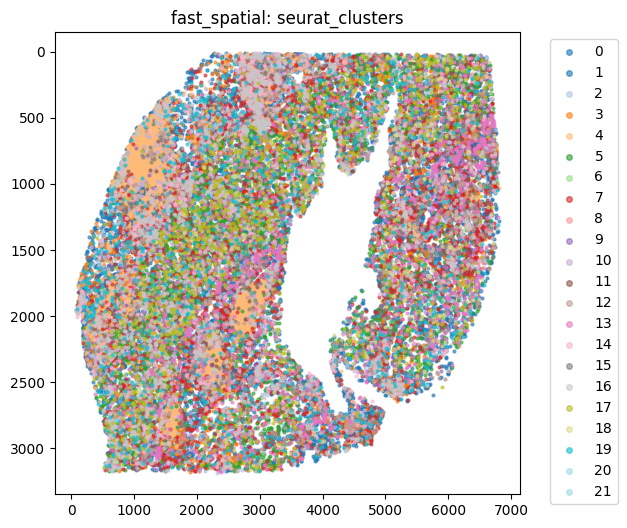

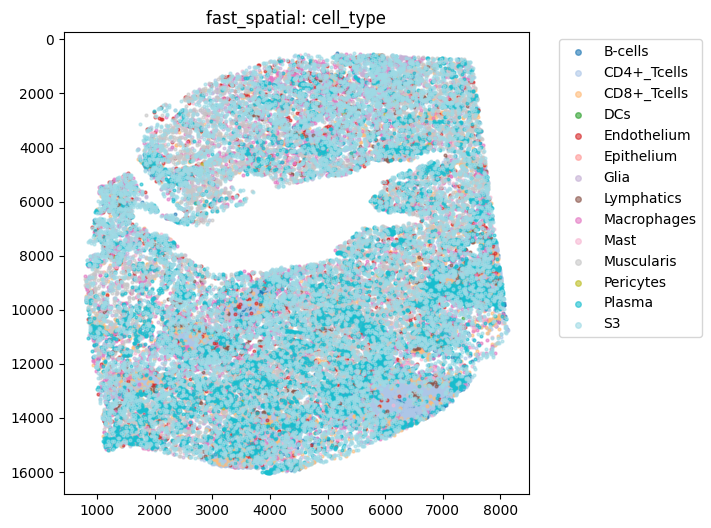

In [3]:
# --- labelled single-cell data ---
adata_labelled = sc.read_h5ad("/project/simmons_hts/kxu/hest/xenium_labelled/h5ad/XeniumPR1S2ROI6.h5ad")

adata_labelled.obsm["spatial"] = adata_labelled.obs[["cell_centroid_x","cell_centroid_y"]].to_numpy()

fast_spatial(adata_labelled, 'predicted.id')
fast_spatial(adata_labelled, 'seurat_clusters')

# --- filter st.adata to WSI extent + drop Codeword features ---
update_st_with_filtered_and_labelled(st, adata_labelled, drop_codeword=True)

# --- align labelled cells to H&E pixel coords ---
px_um = st.meta["pixel_size"]
adata_labelled = align_labelled_to_he(adata_labelled, align_csv, pixel_size_um=px_um)

# standardize column names / annotate
adata_labelled = standardize_obs_columns(adata_labelled)
fast_spatial(adata_labelled, 'cell_type')

Spots kept after rules: 8075 / 8326


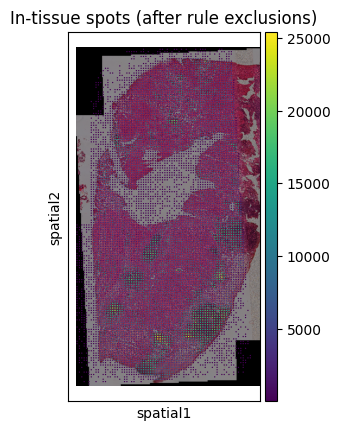

In [5]:
# --- spot exclusions across full WSI (no cell bbox restriction) ---
# get spot coords from st.adata
xy = st.adata.obsm["spatial"]
sx, sy = xy[:, 0], xy[:, 1]

# full WSI bounding box
xmin, xmax, ymin, ymax = 0, st.wsi.width, 0, st.wsi.height

# rules (edit as you like)
rules = [
    {"type": "corner", "corner": "top-left", "width": 0.06, "height": 0.52, "units": "frac"}
]

# apply rule-based exclusions directly
final_keep = apply_spot_exclusions(sx, sy, (xmin, xmax, ymin, ymax), rules)

print(f"Spots kept after rules: {final_keep.sum()} / {len(final_keep)}")

# visualize with scanpy
sc.pl.spatial(
    st.adata[final_keep],
    size=0.5,
    img_key="downscaled_fullres",
    color="total_counts",
    title="In-tissue spots (after rule exclusions)",
)

Before/After: {'old': {'num_cells': 52284, 'cells_under_tissue': 52284, 'transcripts_per_cell': 95.0392089358121, 'total_cell_area': 833128.6477618205}, 'new': {'num_cells': 52284, 'cells_under_tissue': 52284, 'transcripts_per_cell': 95.0392089358121, 'total_cell_area': 833128.6477618205}}
saving to pyramidal tiff... can be slow


/home/k/kxu/.local/lib/python3.11/site-packages/hest/h5ad_reader.py:319: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


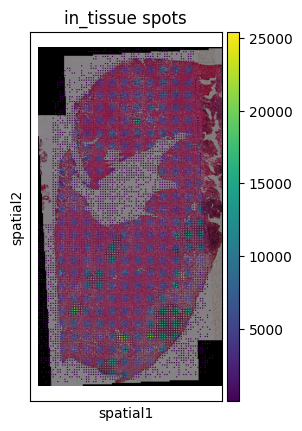

Overlay saved: /project/simmons_hts/kxu/hest/xenium_data/XeniumPR1_50um/slide2/ROI6/cell_plot.png


In [8]:
# reattach (after alignment/renames)
st.adata = st.adata[final_keep]
st.cell_adata = adata_labelled

# --- meta refresh ---
stats = refresh_meta_counts(st)
print("Before/After:", stats)

out_dir = Path("/project/simmons_hts/kxu/hest/xenium_data/XeniumPR1_50um/slide2/ROI6")
overlay_path = save_all(st, out_dir, pyramidal=True, size = 0.5)
print("Overlay saved:", overlay_path)

# XeniumPR1S2ROI7

In [37]:
# only change sample ID once here
sample_id = "TIP864"
exp_stem = Path("/project/simmons_hts/shared/20_11_2024_xenium_prime_run1/20241113__143534__SIMMONS_super_secret_prime_run1/output-XETG00283__0043720__Region_1__20241113__143611")
img_path  = Path(f"/project/simmons_hts/jpark/1_project/0_xenium/RUNTRexBio/post_HnE/{sample_id}_Xenium5K_post_HnE.ome.tif")
align_csv = Path(f"/project/simmons_hts/jpark/1_project/0_xenium/RUNTRexBio/post_HnE/{sample_id}_Xenium5K_post_HnE_matrix.csv")
st = load_xenium_dataset(exp_stem, img_path, align_csv, use_dask=True, spot_size_um = 50)

Loading the WSI... (can be slow for large images)
Loading transcripts...
Pooling xenium transcripts in pseudo-visium spots...
Reading cells...


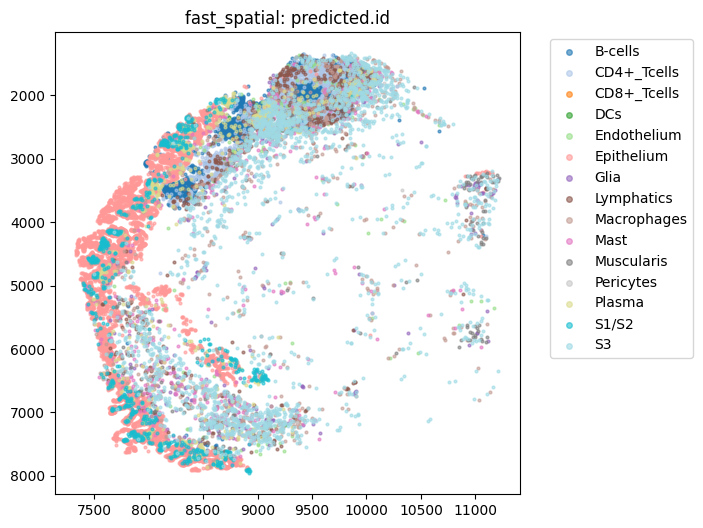

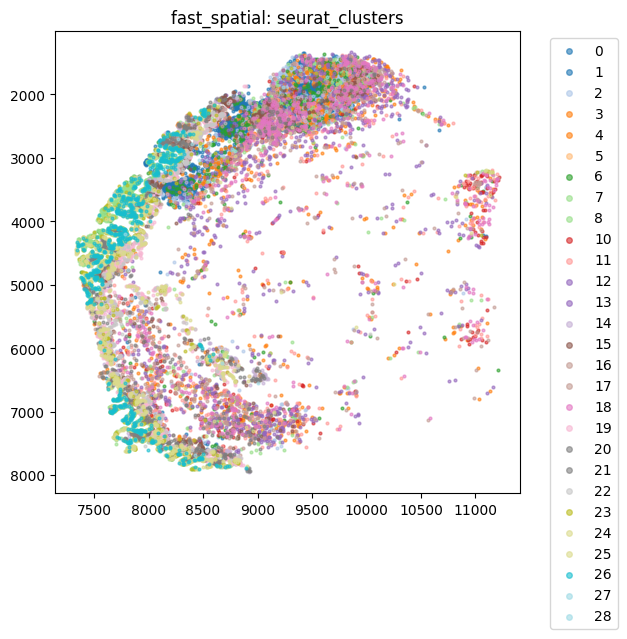

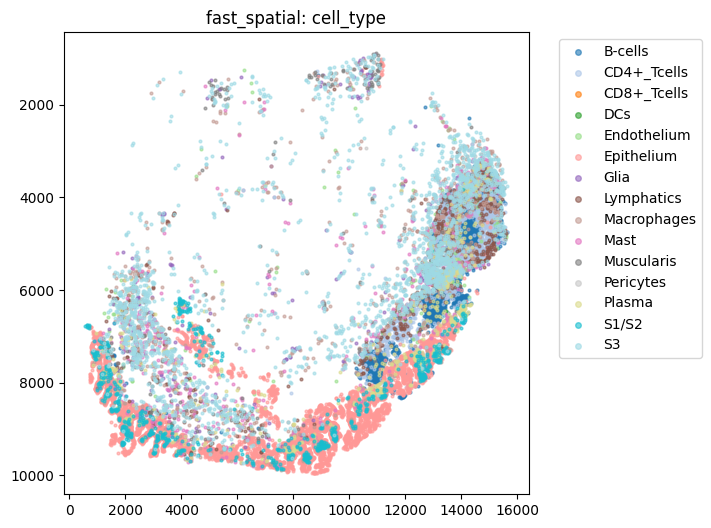

In [38]:
# --- labelled single-cell data ---
adata_labelled = sc.read_h5ad("/project/simmons_hts/kxu/hest/xenium_labelled/h5ad/XeniumPR1S2ROI7.h5ad")

adata_labelled.obsm["spatial"] = adata_labelled.obs[["cell_centroid_x","cell_centroid_y"]].to_numpy()

fast_spatial(adata_labelled, 'predicted.id')
fast_spatial(adata_labelled, 'seurat_clusters')

# --- filter st.adata to WSI extent + drop Codeword features ---
update_st_with_filtered_and_labelled(st, adata_labelled, drop_codeword=True)

# --- align labelled cells to H&E pixel coords ---
px_um = st.meta["pixel_size"]
adata_labelled = align_labelled_to_he(adata_labelled, align_csv, pixel_size_um=px_um)

# standardize column names / annotate
adata_labelled = standardize_obs_columns(adata_labelled)
fast_spatial(adata_labelled, 'cell_type')

Before/After: {'old': {'num_cells': 1090005, 'cells_under_tissue': 1090005, 'transcripts_per_cell': 140, 'total_cell_area': 53266916.81791191}, 'new': {'num_cells': 15941, 'cells_under_tissue': 15941, 'transcripts_per_cell': 58.48886519038956, 'total_cell_area': 245697.36461167}}
saving to pyramidal tiff... can be slow


/home/k/kxu/.local/lib/python3.11/site-packages/hest/h5ad_reader.py:319: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


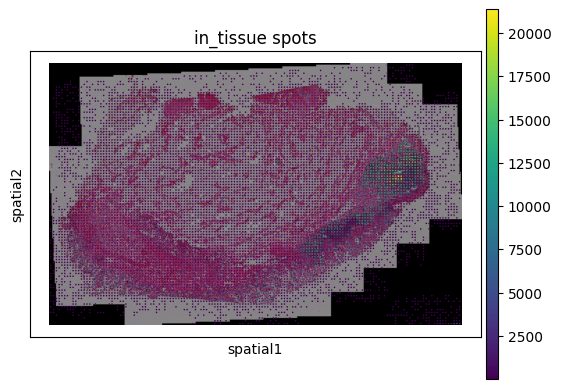

Overlay saved: /project/simmons_hts/kxu/hest/xenium_data/XeniumPR1_50um/slide2/ROI7/cell_plot.png


In [39]:
st.cell_adata = adata_labelled

# --- meta refresh ---
stats = refresh_meta_counts(st)
print("Before/After:", stats)

out_dir = Path("/project/simmons_hts/kxu/hest/xenium_data/XeniumPR1_50um/slide2/ROI7")
overlay_path = save_all(st, out_dir, pyramidal=True,size=0.5)
print("Overlay saved:", overlay_path)

# Visualise all samples

In [11]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
from pathlib import Path

def show_plots(directory: str | Path, pattern: str = "*cell_plot*.png", ncols: int = 3, figsize=(15, 10)):
    """
    Recursively search for and display all matching plots (cell or spatial) from subdirectories in a grid.

    Args:
        base_dir (str | Path): Root directory containing slides/ROIs.
        pattern (str): Glob pattern (e.g. '*cell_plot*.png' or '*spatial_plot*.png').
        ncols (int): Number of columns in the display grid.
        figsize (tuple): Figure size for matplotlib.
    """
    base_dir = Path(directory)
    imgs = sorted(base_dir.rglob(pattern))  # recursive search

    if not imgs:
        print(f"No images found matching pattern '{pattern}' in {directory}")
        return

    n = len(imgs)
    nrows = (n + ncols - 1) // ncols

    fig, axes = plt.subplots(nrows, ncols, figsize=figsize)
    axes = axes.flatten() if nrows > 1 or ncols > 1 else [axes]

    for ax, img_path in zip(axes, imgs):
        img = mpimg.imread(img_path)
        ax.imshow(img)
        ax.set_title(img_path.name, fontsize=9)
        ax.axis("off")

    # Hide any unused subplots
    for ax in axes[len(imgs):]:
        ax.axis("off")

    plt.tight_layout()
    plt.show()



In [13]:
show_plots(
    "/project/simmons_hts/kxu/hest/xenium_data/XeniumPR1_50um/",
    pattern="*cell_plot*.png",
    ncols=5,
    figsize=(18, 10)
)

In [23]:
from pathlib import Path
import math
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
from PIL import Image, ImageOps
import numpy as np

from pathlib import Path
import math
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image, ImageOps

def show_all_plots_in_grid_downsampled(
    base_dir: str | Path,
    pattern: str = "*cell_plot*.png",
    ncols: int = 3,
    figsize=(16, 10),
    max_side: int = 800,
    per_page: int | None = 12,
    resample=Image.LANCZOS,
    save_dir: str | Path | None = None,
    save_prefix: str = "plots",
    show: bool = True,
    dpi: int = 150,
):
    """
    Recursively search for images, downsample and display in a grid.
    Optionally save each page to PNG files in save_dir with prefix save_prefix.

    Minimal change from your existing function: only adds saving behavior.
    """
    base_dir = Path(base_dir)
    imgs = sorted(base_dir.rglob(pattern))
    if not imgs:
        print(f"No images found matching '{pattern}' under {base_dir}")
        return

    if save_dir is not None:
        save_dir = Path(save_dir)
        save_dir.mkdir(parents=True, exist_ok=True)

    def load_thumbnail(path: Path, max_side: int):
        with Image.open(path) as im:
            im = ImageOps.exif_transpose(im)
            if im.mode not in ("RGB", "L"):
                im = im.convert("RGB")
            im.thumbnail((max_side, max_side), resample=resample)
            return np.asarray(im)

    total = len(imgs)
    per_page = total if per_page is None else per_page
    pages = math.ceil(total / per_page)

    for page in range(pages):
        start = page * per_page
        end = min(start + per_page, total)
        page_imgs = imgs[start:end]
        n = len(page_imgs)
        nrows = math.ceil(n / ncols)

        fig, axes = plt.subplots(nrows, ncols, figsize=figsize)
        if isinstance(axes, np.ndarray):
            axes = axes.flatten()
        else:
            axes = [axes]

        for ax in axes:
            ax.axis("off")

        for ax, img_path in zip(axes, page_imgs):
            try:
                arr = load_thumbnail(img_path, max_side=max_side)
                rel_path = img_path.relative_to(base_dir)
                ax.imshow(arr)
                ax.set_title(str(rel_path), fontsize=8)
            except Exception as e:
                ax.text(0.5, 0.5, f"Error\n{img_path.name}", ha="center")
                ax.set_title(str(img_path.name), fontsize=8)
            ax.axis("off")

        for ax in axes[len(page_imgs):]:
            ax.axis("off")

        plt.tight_layout()

        # --- Save each page as PNG if requested (minimal change) ---
        if save_dir is not None:
            fname = f"{save_prefix}_page_{page+1:02d}.png"
            outpath = save_dir / fname
            fig.savefig(outpath, dpi=dpi, bbox_inches="tight")
            print(f"Saved page {page+1}/{pages} -> {outpath}")

        # Show interactive figure if requested
        if show:
            plt.show()
        else:
            plt.close(fig)
            

Saved page 1/2 -> /project/simmons_hts/kxu/hest/xenium_data/XeniumPR1_50um/spatial_plots_page_01.png


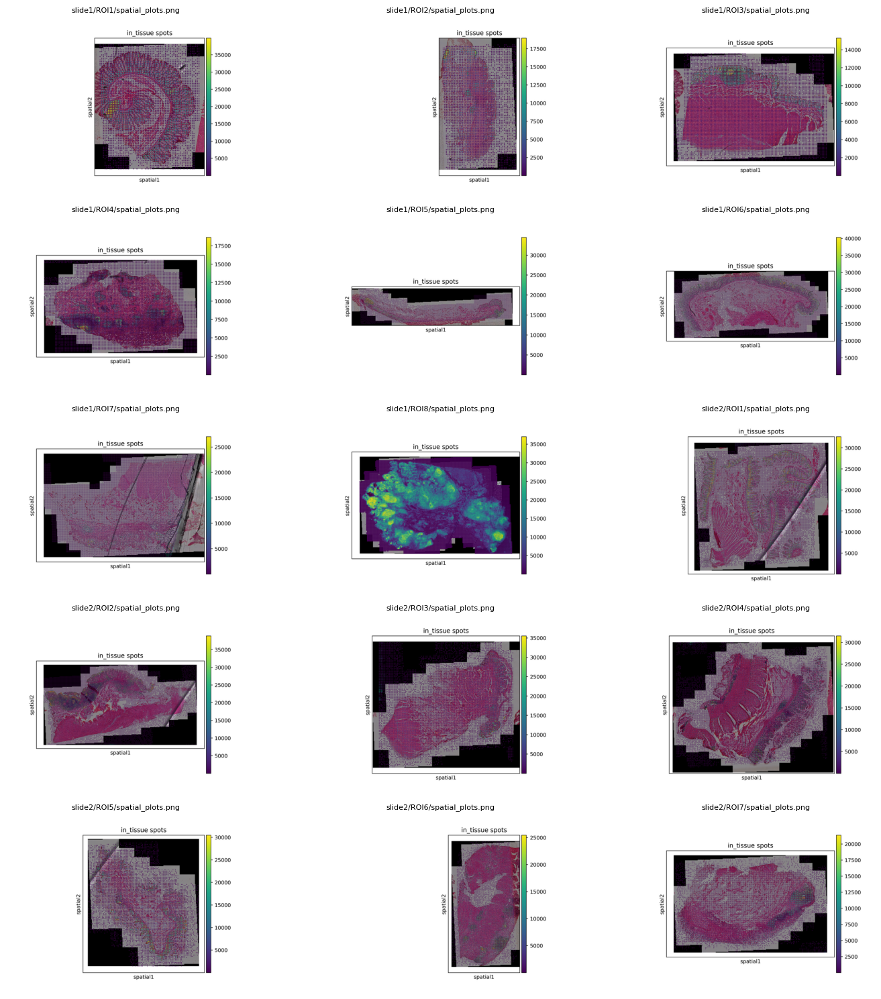

Saved page 2/2 -> /project/simmons_hts/kxu/hest/xenium_data/XeniumPR1_50um/spatial_plots_page_02.png


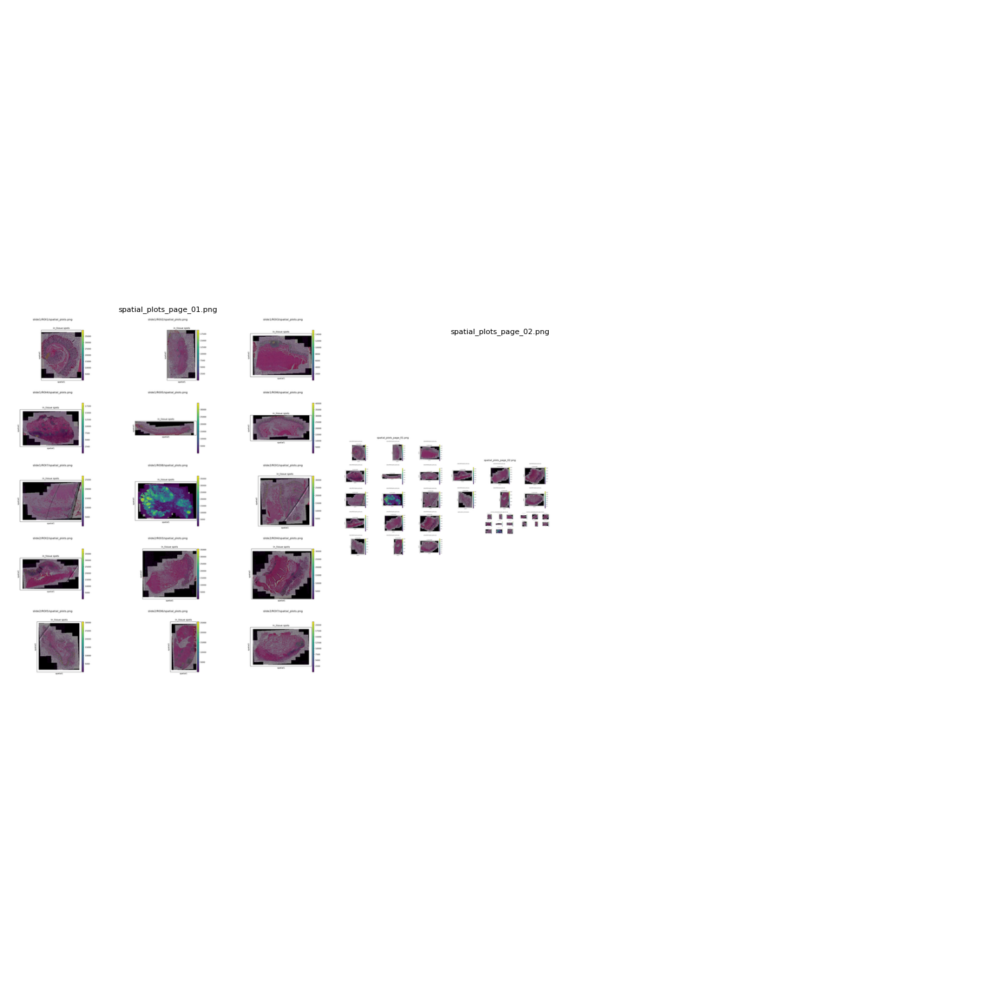

In [24]:
show_all_plots_in_grid_downsampled(
    base_dir="/project/simmons_hts/kxu/hest/xenium_data/XeniumPR1_50um",
    pattern="*spatial_plot*.png",
    ncols=3,
    figsize=(15, 15),
    max_side=600,
    per_page=15,
    save_dir="/project/simmons_hts/kxu/hest/xenium_data/XeniumPR1_50um",
    save_prefix="spatial_plots",
    show=True,
    dpi=200,
)

Saved page 1/1 -> /project/simmons_hts/kxu/hest/xenium_data/XeniumPR1_50um/cell_plots_page_01.png


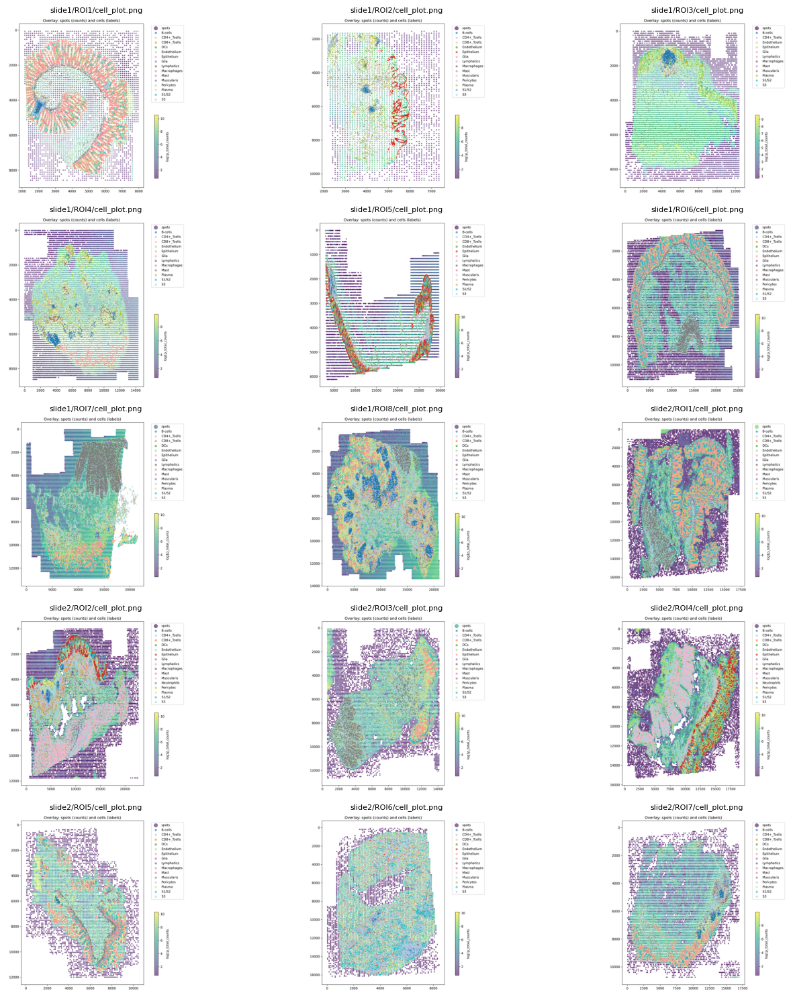

In [25]:
show_all_plots_in_grid_downsampled(
    base_dir="/project/simmons_hts/kxu/hest/xenium_data/XeniumPR1_50um",
    pattern="*cell_plot*.png",
    ncols=3,
    figsize=(15, 15),
    max_side=600,
    per_page=15,
    save_dir="/project/simmons_hts/kxu/hest/xenium_data/XeniumPR1_50um",
    save_prefix="cell_plots",
    show=True,
    dpi=200,
)